In [1]:
#importing required libraries

import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler,OneHotEncoder
from sklearn.compose import make_column_transformer
from sklearn.pipeline import make_pipeline
from sklearn.cluster import KMeans

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
from plotly import tools
import chart_studio.plotly as py

from collections import Counter
from pandas_profiling import ProfileReport
import datetime as dt

In [2]:
# importing all data files

account_df = pd.read_excel(r'D:\coderush\Project\data_excel\account.xlsx')
card_df = pd.read_excel(r'D:\coderush\Project\data_excel\card.xlsx')
client_df = pd.read_excel(r'D:\coderush\Project\data_excel\client.xlsx')
dis_df = pd.read_excel(r'D:\coderush\Project\data_excel\dis.xlsx')
district_df = pd.read_excel(r'D:\coderush\Project\data_excel\district.xlsx')
loan_df = pd.read_excel(r'D:\coderush\Project\data_excel\loan.xlsx')
order_df = pd.read_excel(r'D:\coderush\Project\data_excel\order.xlsx')
trans_df = pd.read_excel(r'D:\coderush\Project\data_excel\trans.xlsx')

In [221]:
# generating profile report for accounts
profile = ProfileReport(account_df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [223]:
# generating profile report for accounts
profile = ProfileReport(client_df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [224]:
# generating profile report for loan
profile = ProfileReport(loan_df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [225]:
# generating profile report for accounts
profile = ProfileReport(dis_df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [226]:
# generating profile report for accounts
profile = ProfileReport(district_df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [227]:
# generating profile report for accounts
profile = ProfileReport(trans_df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [222]:
# generating  profile report for cards
profile = ProfileReport(card_df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [3]:
# listing all dataframes

files = [account_df, card_df, client_df, dis_df, district_df, loan_df, order_df, trans_df]
data_correlated_files = [ trans_df, account_df, loan_df]
files_name = ['account_df', 'card_df', 'client_df', 'dis_df', 'district_df', 'loan_df', 'trans_df']

In [4]:
# changing dateformat from(YYMMDD) to (YYYYMMDD)
def date_correction (df, col_name):
    df [col_name] = pd.to_datetime (df [col_name], format = '%y%m%d', errors = 'coerce')
    return df
 
#correction of date misinterpretation when 45 treated as 2045 and not 1945
def date_misinterp_cor (date):
    if date.year > 2000: 
        date = date.replace (year = date.year - 100)
        return date
    else:
        return date

    
# calculate age with birthdate
def calculate_age (born_date):
    born = born_date.year
    return 1998 - born


# extracting only  date from the string
def date_parsing (date):
    date = int (str (date) [0:6])
    date2 = pd.to_datetime (date, format = '%y%m%d', errors = 'coerce')
    if date2.year > 2000: 
        return date2.year - 100
    else:
        return date2.year
#extract year and retuen in date format    
def year_extract (date):
    if date.year > 2000: 
        return date.year - 100
    else:
        return date.year

In [5]:
#Normalise dataframe by the total sum of each line
def df_row_normalize(dataframe):
    return dataframe.div(dataframe.sum(axis=1), axis=0)

In [6]:
# describing numeric statistics and checking null values in all dataframes

for id,item in enumerate(files):
    print(str(files_name[id]))
    print("Rows:" + str(item.shape [0]))
    print("Columns:" + str(item.shape[1]))
    display(item.describe())
    display(item.isnull().sum())
    print("*"*50)

account_df
Rows:4500
Columns:4


,account_id,district_id,date
count,4500.000000,4500.000000,4500.000000
mean,2786.067556,37.310444,951654.608667
std,2313.811984,25.177217,14842.188377
min,1.000000,1.000000,930101.000000
25%,1182.750000,13.000000,931227.000000
50%,2368.000000,38.000000,960102.000000
75%,3552.250000,60.000000,961101.000000
max,11382.000000,77.000000,971229.000000


account_id     0
district_id    0
frequency      0
date           0
dtype: int64

**************************************************
card_df
Rows:892
Columns:4


,card_id,disp_id
count,892.000000,892.000000
mean,480.855381,3511.862108
std,306.933982,2984.373626
min,1.000000,9.000000
25%,229.750000,1387.000000
50%,456.500000,2938.500000
75%,684.250000,4459.500000
max,1247.000000,13660.000000


card_id    0
disp_id    0
type       0
issued     0
dtype: int64

**************************************************
client_df
Rows:5369
Columns:3


,client_id,birth_number,district_id
count,5369.000000,5369.000000,5369.000000
mean,3359.011920,535114.970013,37.310114
std,2832.911984,172895.618429,25.043690
min,1.000000,110820.000000,1.000000
25%,1418.000000,406009.000000,14.000000
50%,2839.000000,540829.000000,38.000000
75%,4257.000000,681013.000000,60.000000
max,13998.000000,875927.000000,77.000000


client_id       0
birth_number    0
district_id     0
dtype: int64

**************************************************
dis_df
Rows:5369
Columns:4


,disp_id,client_id,account_id
count,5369.000000,5369.000000,5369.000000
mean,3337.097970,3359.011920,2767.496927
std,2770.418826,2832.911984,2307.843630
min,1.000000,1.000000,1.000000
25%,1418.000000,1418.000000,1178.000000
50%,2839.000000,2839.000000,2349.000000
75%,4257.000000,4257.000000,3526.000000
max,13690.000000,13998.000000,11382.000000


disp_id       0
client_id     0
account_id    0
type          0
dtype: int64

**************************************************
district_df
Rows:77
Columns:16


,A1,A4,A5,A6,A7,A8,A9,A10,A11,A13,A14,A16
count,77.000000,7.700000e+01,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000,77.000000
mean,39.000000,1.338849e+05,48.623377,24.324675,6.272727,1.727273,6.259740,63.035065,9031.675325,3.787013,116.129870,5030.831169
std,22.371857,1.369135e+05,32.741829,12.780991,4.015222,1.008338,2.435497,16.221727,790.202347,1.908480,16.608773,11270.796786
min,1.000000,4.282100e+04,0.000000,0.000000,0.000000,0.000000,1.000000,33.900000,8110.000000,0.430000,81.000000,888.000000
25%,20.000000,8.585200e+04,22.000000,16.000000,4.000000,1.000000,5.000000,51.900000,8512.000000,2.310000,105.000000,2122.000000
50%,39.000000,1.088710e+05,49.000000,25.000000,6.000000,2.000000,6.000000,59.800000,8814.000000,3.600000,113.000000,3040.000000
75%,58.000000,1.390120e+05,71.000000,32.000000,8.000000,2.000000,8.000000,73.500000,9317.000000,4.790000,126.000000,4595.000000
max,77.000000,1.204953e+06,151.000000,70.000000,20.000000,5.000000,11.000000,100.000000,12541.000000,9.400000,167.000000,99107.000000


A1     0
A2     0
A3     0
A4     0
A5     0
A6     0
A7     0
A8     0
A9     0
A10    0
A11    0
A12    0
A13    0
A14    0
A15    0
A16    0
dtype: int64

**************************************************
loan_df
Rows:682
Columns:7


,loan_id,account_id,date,amount,duration,payments
count,682.000000,682.000000,682.000000,682.000000,682.000000,682.000000
mean,6172.466276,5824.162757,963027.910557,151410.175953,36.492669,4190.664223
std,682.579279,3283.512681,14616.406049,113372.406310,17.075219,2215.830344
min,4959.000000,2.000000,930705.000000,4980.000000,12.000000,304.000000
25%,5577.500000,2967.000000,950704.500000,66732.000000,24.000000,2477.000000
50%,6176.500000,5738.500000,970206.500000,116928.000000,36.000000,3934.000000
75%,6752.500000,8686.000000,971212.500000,210654.000000,48.000000,5813.500000
max,7308.000000,11362.000000,981208.000000,590820.000000,60.000000,9910.000000


loan_id       0
account_id    0
date          0
amount        0
duration      0
payments      0
status        0
dtype: int64

**************************************************
trans_df
Rows:6471
Columns:6


,order_id,account_id,account_to,amount
count,6471.000000,6471.000000,6.471000e+03,6471.000000
mean,33778.197497,2962.302890,4.939904e+07,3280.635698
std,3737.681949,2518.503228,2.888356e+07,2714.475335
min,29401.000000,1.000000,3.990000e+02,1.000000
25%,31187.500000,1223.000000,2.415918e+07,1241.500000
50%,32988.000000,2433.000000,4.975606e+07,2596.000000
75%,34785.500000,3645.500000,7.400045e+07,4613.500000
max,46338.000000,11362.000000,9.999420e+07,14882.000000


order_id      0
account_id    0
bank_to       0
account_to    0
amount        0
k_symbol      0
dtype: int64

**************************************************


IndexError: list index out of range

In [7]:
trans_df.isnull().sum()


trans_id           0
account_id         0
date               0
type               0
operation     178663
amount             0
balance            0
k_symbol      478646
bank          775067
account       753573
dtype: int64

In [8]:
trans_df.describe()


,account_id,date,amount,balance,account
count,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,2.950020e+05
mean,2.936279e+03,9.655599e+05,5.942083e+03,3.845668e+04,4.573083e+07
std,2.477154e+03,1.393231e+04,9.529359e+03,2.206855e+04,3.063882e+07
min,1.000000e+00,9.301010e+05,0.000000e+00,-4.112570e+04,0.000000e+00
25%,1.204000e+03,9.601130e+05,1.359000e+02,2.238840e+04,1.790311e+07
50%,2.434000e+03,9.704060e+05,2.100000e+03,3.309880e+04,4.581671e+07
75%,3.659000e+03,9.802120e+05,6.817000e+03,4.950220e+04,7.209694e+07
max,1.138200e+04,9.812190e+05,8.740000e+04,2.096370e+05,9.999420e+07


In [9]:
trans_df.shape

(1048575, 10)

In [10]:
for id, item in enumerate (data_correlated_files): 
    data_correlated_files [id] = date_correction (item, 'date')

trans_df = data_correlated_files [0]
account_df = data_correlated_files [1]
loan_df = data_correlated_files [2]

In [11]:
trans_df.head(5)

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account
0,695247,2378,1993-01-01,PRIJEM,Credit in cash,700.0,700.0,NaN,NaN,NaN
1,171812,576,1993-01-01,PRIJEM,Credit in cash,900.0,900.0,NaN,NaN,NaN
2,207264,704,1993-01-01,PRIJEM,Credit in cash,1000.0,1000.0,NaN,NaN,NaN
3,1117247,3818,1993-01-01,PRIJEM,Credit in cash,600.0,600.0,NaN,NaN,NaN
4,579373,1972,1993-01-02,PRIJEM,Credit in cash,400.0,400.0,NaN,NaN,NaN


In [12]:
account_df.head(5)

,account_id,district_id,frequency,date
0,576,55,Monthly fee,1993-01-01
1,3818,74,Monthly fee,1993-01-01
2,704,55,Monthly fee,1993-01-01
3,2378,16,Monthly fee,1993-01-01
4,2632,24,Monthly fee,1993-01-02


In [13]:
loan_df.head(5)

,loan_id,account_id,date,amount,duration,payments,status
0,5314,1787,1993-07-05,96396,12,8033,B
1,5316,1801,1993-07-11,165960,36,4610,A
2,6863,9188,1993-07-28,127080,60,2118,A
3,5325,1843,1993-08-03,105804,36,2939,A
4,7240,11013,1993-09-06,274740,60,4579,A


# Customer Analysis

In [14]:
#adding new columns birthdate, age, gender

client_df = client_df.join (pd.DataFrame ( { 'birth_date': np.nan, 'gender': np.nan, 'age': np.nan}, index = client_df.index))

In [15]:
# fill new column birth date and gender with birth number

client_df ['birth_date'] = client_df ['birth_number']
for ids, item in enumerate (client_df ['birth_number']):
    if int (str (item) [2:4]) > 50:
        client_df.loc [ids, 'gender'] = 0 
        client_df.loc [ids, 'birth_date'] = item - 5000 
    else: 
        client_df.loc [ids, 'gender'] = 1
        
#female = 0
#male = 1

In [16]:
#converting birth_date into date format

client_df = date_correction (client_df, 'birth_date') 

In [17]:
#correcting misinterpreted dates

client_df ['birth_date'] = client_df ['birth_date'].apply (date_misinterp_cor)

In [18]:
#calculating age from birth date

client_df ['age'] = client_df ['birth_date'].apply (calculate_age)
display (client_df.head (3))

,client_id,birth_number,district_id,birth_date,gender,age
0,1,706213,18,1970-12-13,0.0,28
1,2,450204,1,1945-02-04,1.0,53
2,3,406009,1,1940-10-09,0.0,58


<AxesSubplot:title={'center':'Clients distribution per age'}, ylabel='Frequency'>

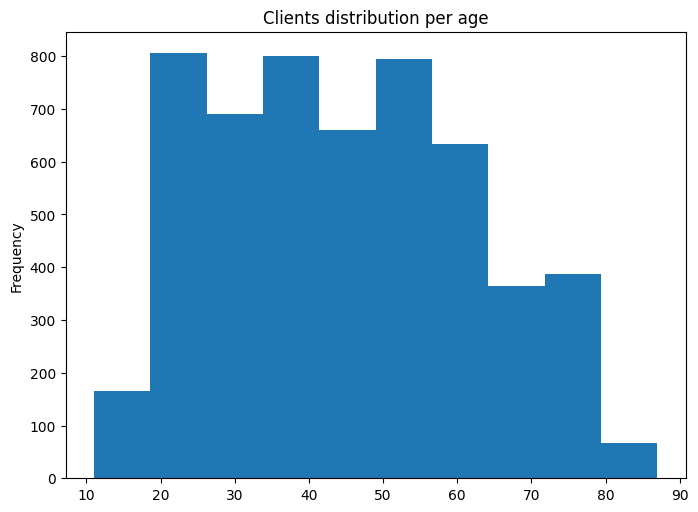

In [19]:
#plotting customers distribution by age

client_df ['age'].plot (kind = 'hist', title = 'Clients distribution per age', figsize = (8, 5.8))

In [20]:
#Clients gender visualization

target1 = client_df [client_df ['gender'] == 1.0].shape [0]
target0 = client_df [client_df ['gender'] == 0.0].shape [0]

percentage_male = target1/ (target1 + target0) *100
percentage_female = target0/ (target1 + target0) *100

trace0 = go.Bar (
    x = ['Men', 'Women'],
    y = [percentage_male, percentage_female])

data = [trace0]

layout = go.Layout (title = 'Gender proportion (%)', autosize= False, width= 500, height= 500)
fig = go.Figure (data = data, layout = layout)
fig.show()
print("Percentage of male: " + str(percentage_male) + "\nPercentage of female: " + str(percentage_female))


Percentage of male: 50.73570497299311
Percentage of female: 49.264295027006895


In [21]:
#merging client_df with district_df

client_dist_df = client_df.merge (district_df, left_on = 'district_id', right_on = 'A1', 
                                           how = 'left', validate = 'many_to_one') 
display (client_df.head (3))
display (client_dist_df.head (3)) 

,client_id,birth_number,district_id,birth_date,gender,age
0,1,706213,18,1970-12-13,0.0,28
1,2,450204,1,1945-02-04,1.0,53
2,3,406009,1,1940-10-09,0.0,58


,client_id,birth_number,district_id,birth_date,gender,age,A1,A2,A3,A4,...,A7,A8,A9,A10,A11,A12,A13,A14,A15,A16
0,1,706213,18,1970-12-13,0.0,28,18,Pisek,south Bohemia,70699,...,2,1,4,65.3,8968,2.83,3.35,131,1740,1910
1,2,450204,1,1945-02-04,1.0,53,1,Hl.m. Praha,Prague,1204953,...,0,1,1,100.0,12541,0.29,0.43,167,85677,99107
2,3,406009,1,1940-10-09,0.0,58,1,Hl.m. Praha,Prague,1204953,...,0,1,1,100.0,12541,0.29,0.43,167,85677,99107


In [22]:
#grouping by district 
#A2: name of district
#A3: name of region
#A4: population of the district
#A11: average salary of district 

district_client_df = pd.DataFrame (client_dist_df.groupby (['A2', 'A4', 'A11'], axis = 0) ['A2'].count ())
district_client_df.columns = ['Customer Count']


#making columns out of multi-index of A2 so to make it easier to operate with values
district_client_df.reset_index (inplace = True)

#calculating percentage of client out of district population
district_client_df ['Percentage'] = district_client_df ['Customer Count'] / district_client_df ['A4'] * 100

display (district_client_df .head (5))
district_client_df ['Customer Count'].sum ()

,A2,A4,A11,Customer Count,Percentage
0,Benesov,88884,8507,46,0.051753
1,Beroun,75232,8980,63,0.083741
2,Blansko,107911,8240,57,0.052821
3,Breclav,124605,8772,54,0.043337
4,Brno - mesto,387570,9897,155,0.039993


5369

<AxesSubplot:title={'center':'Clients distribution per districts'}, ylabel='A2'>

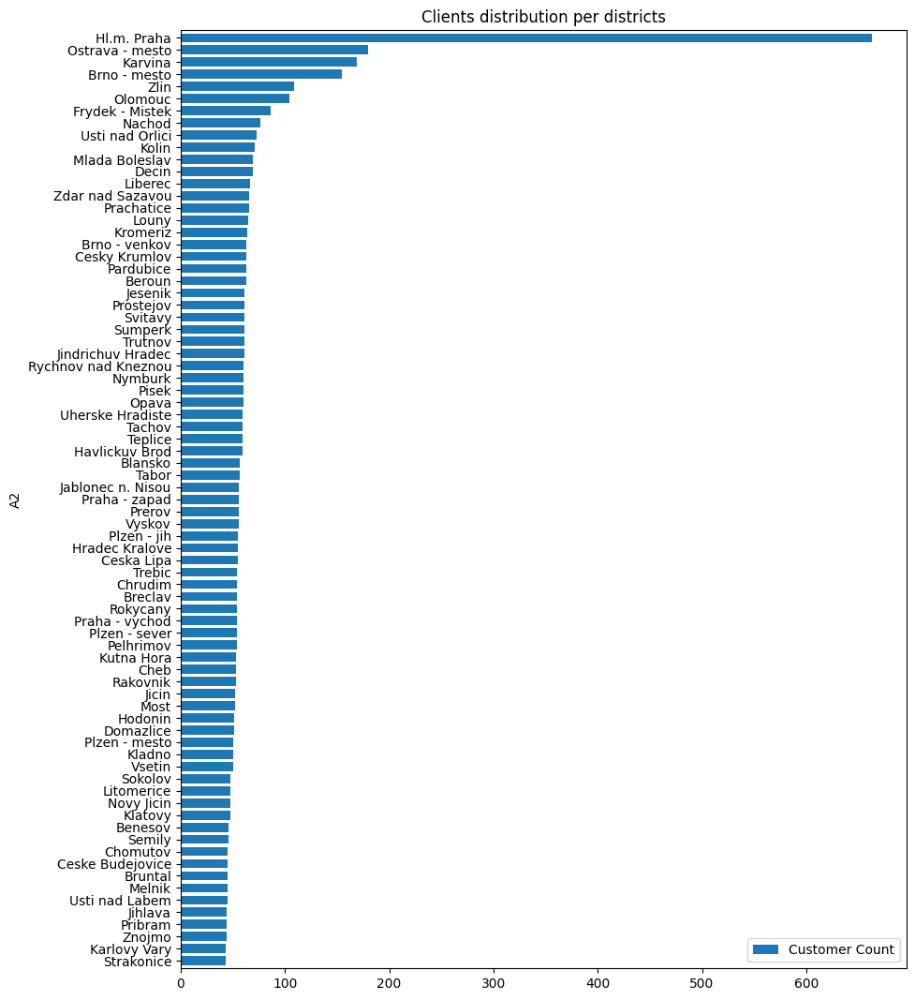

In [23]:
#Plotting clients presence in different districts

client_district_count_df= district_client_df[['A2', 'Customer Count']].sort_values('Customer Count')
client_district_count_df.set_index (['A2'], inplace = True)

client_district_count_df.plot (kind = 'barh',
                    title = 'Clients distribution per districts',
                    width = 0.75,
                    figsize = (10, 13)
                    )


In [24]:
region_client_df = pd.DataFrame (client_dist_df.groupby (['A3'], axis = 0) ['A3'].count ())
region_client_df.columns = ['Customer Count']

#resetting index of column
region_client_df.reset_index (inplace = True)
region_client_df ['Percentage'] = district_client_df ['Customer Count'] / district_client_df ['A4'] * 100

region_client_df ['Customer Count'].sum ()
region_client_df.head(10)

,A3,Customer Count,Percentage
0,Prague,663,0.051753
1,central Bohemia,664,0.083741
2,east Bohemia,660,0.052821
3,north Bohemia,561,0.043337
4,north Moravia,920,0.039993
5,south Bohemia,449,0.040117
6,south Moravia,937,0.042431
7,west Bohemia,515,0.052352


<AxesSubplot:title={'center':'Clients distribution per region'}, ylabel='A3'>

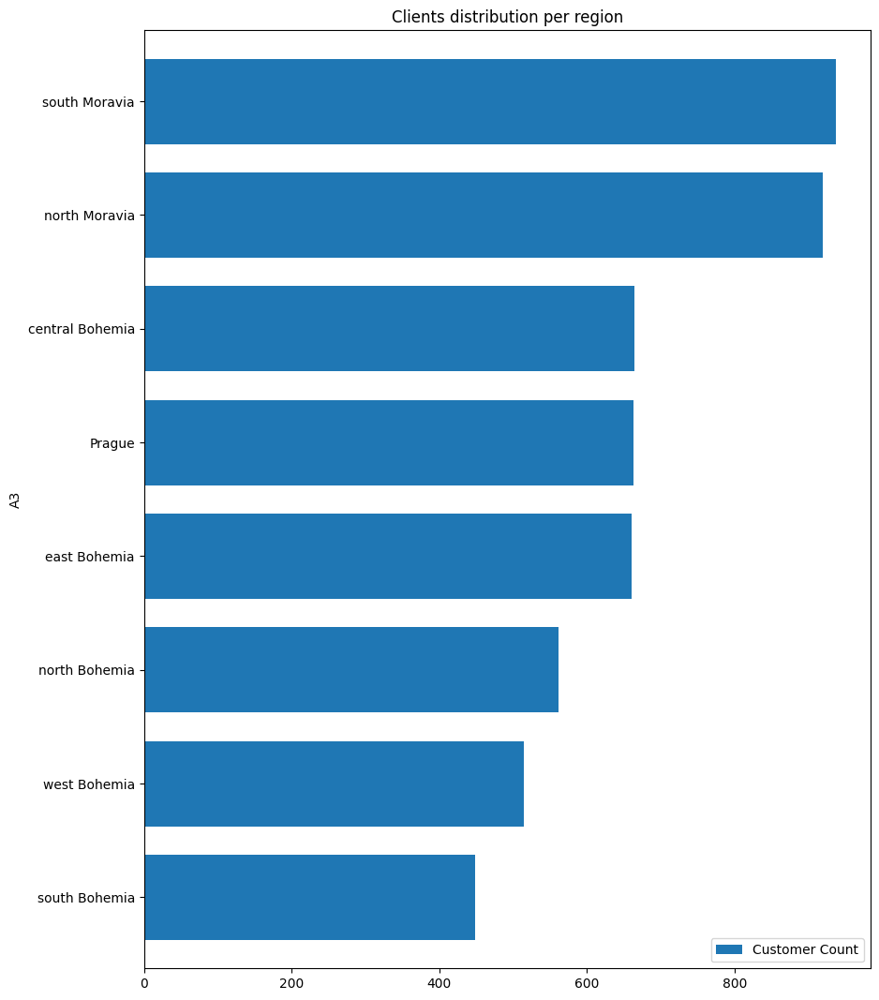

In [25]:
#Plotting clients presence in different districts

client_region_count_df= region_client_df[['A3', 'Customer Count']].sort_values('Customer Count')
client_region_count_df.set_index (['A3'], inplace = True)

client_region_count_df.plot (kind = 'barh',
                    title = 'Clients distribution per region',
                    width = 0.75,
                    figsize = (10, 13)
                    )



In [26]:
#calculating average salaries within district

district_df ['A11'].mean ()

9031.675324675325

In [27]:
#calculating average salries in regions

region_salary_df = pd.DataFrame (district_df.groupby (['A3'], axis = 0) ['A11'].mean ()).sort_values ('A11')
display (region_salary_df.head (10))

,A11
A3,
east Bohemia,8611.181818
south Moravia,8728.500000
south Bohemia,8831.500000
west Bohemia,9015.400000
north Moravia,9049.181818
north Bohemia,9334.200000
central Bohemia,9357.250000
Prague,12541.000000


<AxesSubplot:title={'center':'Average salary per region'}, ylabel='A3'>

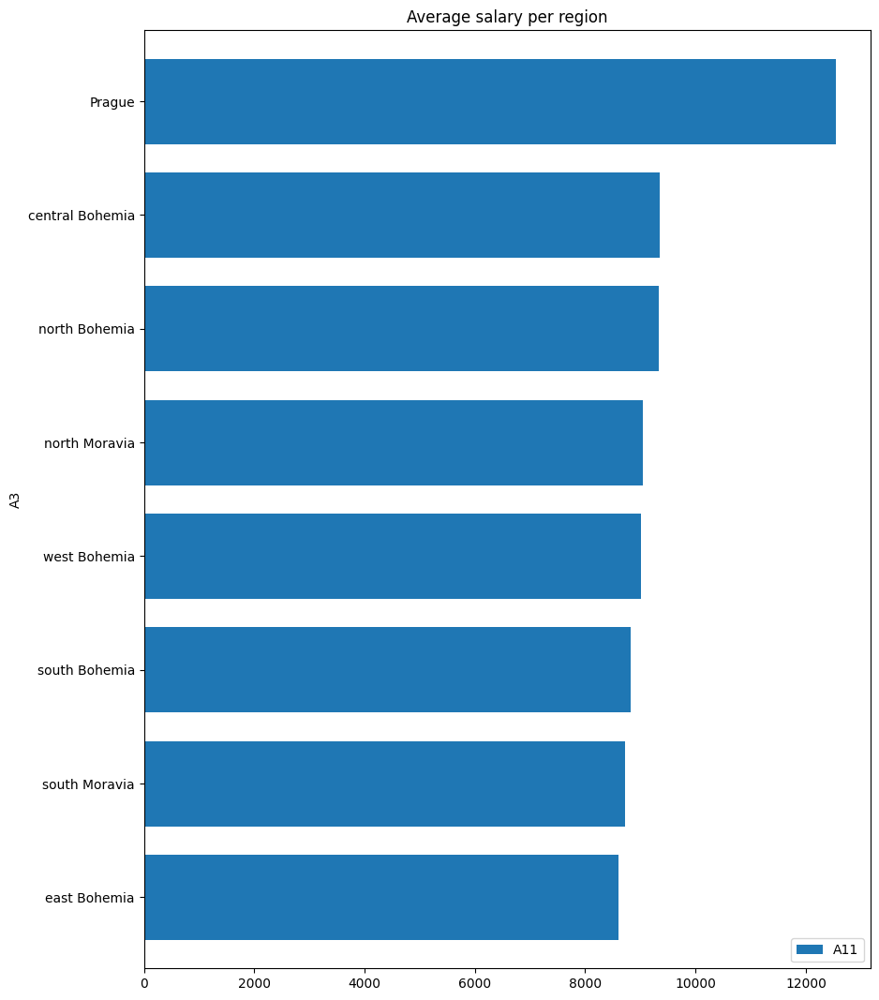

In [28]:
region_salary_df.plot (kind = 'barh',
                    title = 'Average salary per region',
                    width = 0.75,
                    figsize = (10, 13)
                    )

In [29]:
#Plotting average salary per regions
trace0 = go.Bar (
    x = region_salary_df.index,
    y = region_salary_df ['A11'], 
) 
data = [trace0]
layout = go.Layout (title = 'Average salary per region', autosize= False, width= 600, height= 400,
                    )
fig = go.Figure (data=data, layout = layout)
fig.show()

# Card Analysis

Counter({'classic': 659, 'junior': 145, 'gold': 88})

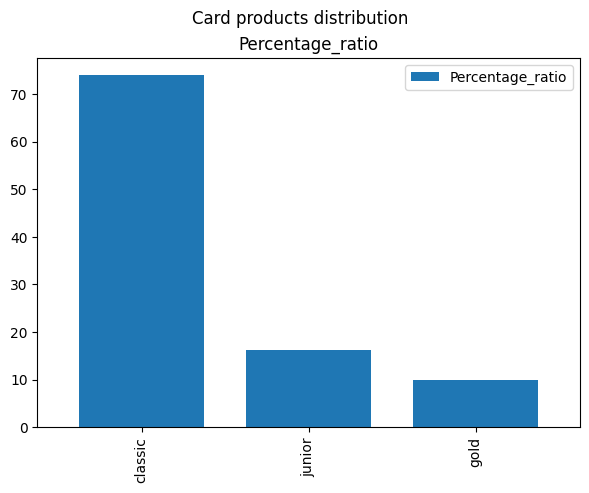

In [30]:
card_count = Counter (card_df ['type'])
card_counts = pd.DataFrame.from_dict (card_count, orient = 'index')
card_counts.columns = ['Percentage_ratio']
card_counts = card_counts / (card_counts ['Percentage_ratio'].sum ()) * 100
card_counts.plot (kind = 'bar',
                    title = 'Card products distribution',
                    width = 0.75,
                    figsize = (7, 4.8),
                    subplots = True
                    )
display (card_count)

In [31]:
#mergeig card and disp dataframe to find client_id

card_1df = card_df
card_dis_df = card_1df.merge (dis_df, left_on = 'disp_id', right_on = 'disp_id', 
                                           how = 'left', validate = 'many_to_one') 
display (card_df.head (n=3))
display (card_dis_df.head (n=3))  

,card_id,disp_id,type,issued
0,1005,9285,classic,931107 00:00:00
1,104,588,classic,940119 00:00:00
2,747,4915,classic,940205 00:00:00


,card_id,disp_id,type_x,issued,client_id,account_id,type_y
0,1005,9285,classic,931107 00:00:00,9593,7753,OWNER
1,104,588,classic,940119 00:00:00,588,489,OWNER
2,747,4915,classic,940205 00:00:00,4915,4078,OWNER


In [32]:
#mergeing card_dis_df with client_dist_df to bring client, card, and region information together
card_dis1_df = card_dis_df
card_dis_dist_df = card_dis1_df.merge (client_dist_df, left_on = 'client_id', right_on = 'client_id', 
                                           how = 'left', validate = 'many_to_one') 
display (card_dis1_df.head (3))
display (card_dis_dist_df.head (3))     


,card_id,disp_id,type_x,issued,client_id,account_id,type_y
0,1005,9285,classic,931107 00:00:00,9593,7753,OWNER
1,104,588,classic,940119 00:00:00,588,489,OWNER
2,747,4915,classic,940205 00:00:00,4915,4078,OWNER


,card_id,disp_id,type_x,issued,client_id,account_id,type_y,birth_number,district_id,birth_date,...,A7,A8,A9,A10,A11,A12,A13,A14,A15,A16
0,1005,9285,classic,931107 00:00:00,9593,7753,OWNER,685128,74,1968-01-28,...,0,1,1,100.0,10673,4.75,5.44,100,18782,18347
1,104,588,classic,940119 00:00:00,588,489,OWNER,606020,61,1960-10-20,...,5,1,6,53.8,8814,4.76,5.74,107,2112,2059
2,747,4915,classic,940205 00:00:00,4915,4078,OWNER,630719,40,1963-07-19,...,6,3,8,85.3,9317,6.49,7.07,97,6949,6872


In [33]:
card_dis_dist_df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 892 entries, 0 to 891
Data columns (total 28 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   card_id       892 non-null    int64         
 1   disp_id       892 non-null    int64         
 2   type_x        892 non-null    object        
 3   issued        892 non-null    object        
 4   client_id     892 non-null    int64         
 5   account_id    892 non-null    int64         
 6   type_y        892 non-null    object        
 7   birth_number  892 non-null    int64         
 8   district_id   892 non-null    int64         
 9   birth_date    892 non-null    datetime64[ns]
 10  gender        892 non-null    float64       
 11  age           892 non-null    int64         
 12  A1            892 non-null    int64         
 13  A2            892 non-null    object        
 14  A3            892 non-null    object        
 15  A4            892 non-null    int64     

In [34]:
#preparing dataset for plotting of number of cards per regions

#grouping by region ("A3") and card product ('type_x') 
region_card_df = pd.DataFrame (card_dis_dist_df.groupby (['A3', 'type_x'], axis = 0) ['type_x'].count ())
region_card_df.columns = ['count']

#making columns out of multi-index of A3 and type_x so to make it easier to operate with values
region_card_df.reset_index (level= ['type_x', 'A3'], inplace = True)
display (region_card_df .head (5))

,A3,type_x,count
0,Prague,classic,96
1,Prague,gold,12
2,Prague,junior,22
3,central Bohemia,classic,88
4,central Bohemia,gold,9


In [35]:
#making copy to prevent updating in dataframe

regions_duplicate = region_card_df.copy () 
for ids, item in enumerate (region_card_df ['A3']):
    count_sum = regions_duplicate.loc [ids, 'count']
    div_sum = regions_duplicate [regions_duplicate ['A3'] == item] ['count']. sum ()
    region_card_df.loc [ids, 'count'] = round (count_sum / (div_sum) *100)
display (region_card_df .head (5))

,A3,type_x,count
0,Prague,classic,74
1,Prague,gold,9
2,Prague,junior,17
3,central Bohemia,classic,73
4,central Bohemia,gold,8


In [36]:
#plotting percentage of card products per regions 
x = list (region_card_df ['A3'].unique()) #region names
y =  list (region_card_df [region_card_df ['type_x'] == 'junior'] ['count']) #junior
y2 = list (region_card_df [region_card_df ['type_x'] == 'classic'] ['count']) #classic
y3 = list (region_card_df [region_card_df ['type_x'] == 'gold'] ['count']) #gold
junior = go.Bar(
    x=x,
    y=y,
    text= y,
    name = 'Junior',
    textposition = 'auto',
    marker=dict(
        color='rgb(158,202,225)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
classic = go.Bar(
    x=x,
    y=y2,
    text=y2,
    name = 'Classic',
    textposition = 'auto',
    marker=dict(
        color='rgb(0,100,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
gold = go.Bar(
    x=x,
    y=y3,
    text=y3,
    name = 'Gold',
    textposition = 'auto',
    marker=dict(
        color='rgb(255,215,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
data = [junior, classic, gold]
fig = go.Figure (data=data)
fig.show()

In [37]:
#preparing dataset for plotting trends of cards issuance per years

#adding a column that will reflect specific year when a card was issued
card_dis_df ['issue_year'] = card_dis_df ['issued']

card_dis_df ['issue_year'] = card_dis_df ['issue_year'].apply (date_parsing)
card_dis_df.head (3)

,card_id,disp_id,type_x,issued,client_id,account_id,type_y,issue_year
0,1005,9285,classic,931107 00:00:00,9593,7753,OWNER,1993
1,104,588,classic,940119 00:00:00,588,489,OWNER,1994
2,747,4915,classic,940205 00:00:00,4915,4078,OWNER,1994


In [38]:
#grouping by issue_year and card type,then counting number of cards 
year_card_df = pd.DataFrame (card_dis_df.groupby (['issue_year', 'type_x'], axis = 0) ['type_x'].count ())
year_card_df.columns = ['count']

#resetting index
year_card_df.reset_index (level= ['type_x', 'issue_year'], inplace = True)
display (year_card_df .head (20))

,issue_year,type_x,count
0,1993,classic,1
1,1994,classic,17
2,1994,junior,4
3,1995,classic,42
4,1995,gold,4
5,1995,junior,17
6,1996,classic,83
7,1996,gold,5
8,1996,junior,28
9,1997,classic,190


In [39]:
#adding missing years and type in year_card_df
list_of_zer = [pd.Series ([1993, 'junior', 0], index = year_card_df.columns),
               pd.Series ([1993, 'gold', 0], index = year_card_df.columns),
               pd.Series ([1994, 'gold', 0], index = year_card_df.columns),
                ]
year_card_df = year_card_df.append (list_of_zer, ignore_index = True)
year_card_df.sort_values (['issue_year', 'type_x'], inplace= True)

#resetting index
year_card_df.reset_index (inplace = True, drop = True) 
display (year_card_df .head (20))

C:\Users\Acer\AppData\Local\Temp\ipykernel_5004\770986359.py:6: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,issue_year,type_x,count
0,1993,classic,1
1,1993,gold,0
2,1993,junior,0
3,1994,classic,17
4,1994,gold,0
5,1994,junior,4
6,1995,classic,42
7,1995,gold,4
8,1995,junior,17
9,1996,classic,83


In [40]:
#plotting number of card products per years 
x = list (year_card_df ['issue_year'].unique()) #years 
y =  list (year_card_df [year_card_df ['type_x'] == 'junior'] ['count']) #junior
y2 = list (year_card_df [year_card_df ['type_x'] == 'classic'] ['count']) #classic
y3 = list (year_card_df [year_card_df ['type_x'] == 'gold'] ['count']) #gold

junior = go.Bar(
    x=x,
    y=y,
    text= y,
    name = 'Junior',
    textposition = 'auto',
    marker=dict(
        color='rgb(158,202,225)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
classic = go.Bar(
    x=x,
    y=y2,
    text=y2,
    name = 'Classic',
    textposition = 'auto',
    marker=dict(
        color='rgb(0,100,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
gold = go.Bar(
    x=x,
    y=y3,
    text=y3,
    name = 'Gold',
    textposition = 'auto',
    marker=dict(
        color='rgb(255,215,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
data = [junior, classic, gold]
fig = go.Figure (data=data)
fig.show()

In [41]:
#making duplicate to prevent updating in dataframe
year_duplicate = year_card_df.copy ()

for ids, item in enumerate (year_card_df ['issue_year']):
    count_sum = year_duplicate.loc [ids, 'count']
    div_sum = year_duplicate [year_duplicate ['issue_year'] == item] ['count']. sum ()
    year_card_df.loc [ids, 'count'] = round (count_sum / (div_sum) *100)
      
display (year_card_df .head (5))

,issue_year,type_x,count
0,1993,classic,100
1,1993,gold,0
2,1993,junior,0
3,1994,classic,81
4,1994,gold,0


In [42]:
#plotting percentafe of card products per years 
x = list (year_card_df ['issue_year'].unique()) #years 
y =  list (year_card_df [year_card_df ['type_x'] == 'junior'] ['count']) #junior
y2 = list (year_card_df [year_card_df ['type_x'] == 'classic'] ['count']) #classic
y3 = list (year_card_df [year_card_df ['type_x'] == 'gold'] ['count']) #gold

junior = go.Bar(
    x=x,
    y=y,
    text= y,
    name = 'Junior',
    textposition = 'auto',
    marker=dict(
        color='rgb(158,202,225)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
classic = go.Bar(
    x=x,
    y=y2,
    text=y2,
    name = 'Classic',
    textposition = 'auto',
    marker=dict(
        color='rgb(0,100,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
gold = go.Bar(
    x=x,
    y=y3,
    text=y3,
    name = 'Gold',
    textposition = 'auto',
    marker=dict(
        color='rgb(255,215,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
data = [junior, classic, gold]
fig= go.Figure(data = data)
fig.show()

# Loan Analysis

In [43]:
#loan category
loan_copy_df = loan_df.copy ()
loan_copy_df ['status_desc'] = loan_df ['status']

dict1 =  {'A':'Contract finished, no problem', 
      'B':'Contract finised, loan was not paid',
      'C':'Runing contract, OK so far',
      'D':'Runing contract, client in debt'
     }
loan_copy_df.status_desc = loan_copy_df.status_desc.replace (dict1)

loan_copy_df ['status_numeric'] = loan_copy_df ['status']

#encoding bad loans as 1 and good ones as -1 
dict2 =  {'A':-1, 
      'B':1,
      'C':-1,
      'D':1
     }
loan_copy_df.status_numeric = loan_copy_df.status_numeric.replace (dict2)
display (loan_copy_df.head (5))

,loan_id,account_id,date,amount,duration,payments,status,status_desc,status_numeric
0,5314,1787,1993-07-05,96396,12,8033,B,"Contract finised, loan was not paid",1
1,5316,1801,1993-07-11,165960,36,4610,A,"Contract finished, no problem",-1
2,6863,9188,1993-07-28,127080,60,2118,A,"Contract finished, no problem",-1
3,5325,1843,1993-08-03,105804,36,2939,A,"Contract finished, no problem",-1
4,7240,11013,1993-09-06,274740,60,4579,A,"Contract finished, no problem",-1


<AxesSubplot:>

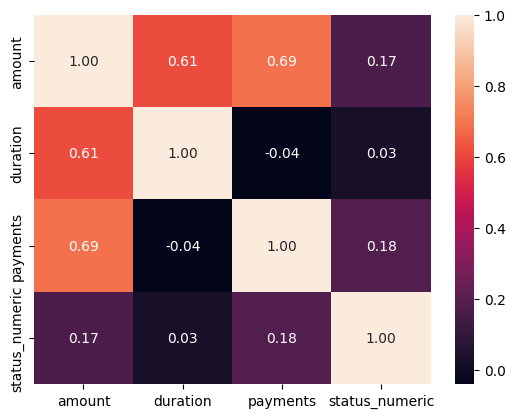

In [44]:
loan_copy_1df = loan_copy_df.copy ()
loan_copy_1df.drop (['loan_id', 'account_id'], axis =1, inplace = True)
sns.heatmap (loan_copy_1df.corr (), annot = True, fmt=".2f")

In [45]:
# mergeing loan daraframe and account daraframe

loan_account_df = loan_copy_df.copy ()
loan_account_df = loan_account_df.merge (account_df, left_on = 'account_id', right_on = 'account_id', 
                                           how = 'left', validate = 'many_to_one') 
display (loan_df.head (3))
display (loan_account_df.head (3))

,loan_id,account_id,date,amount,duration,payments,status
0,5314,1787,1993-07-05,96396,12,8033,B
1,5316,1801,1993-07-11,165960,36,4610,A
2,6863,9188,1993-07-28,127080,60,2118,A


,loan_id,account_id,date_x,amount,duration,payments,status,status_desc,status_numeric,district_id,frequency,date_y
0,5314,1787,1993-07-05,96396,12,8033,B,"Contract finised, loan was not paid",1,30,Fee per week,1993-03-22
1,5316,1801,1993-07-11,165960,36,4610,A,"Contract finished, no problem",-1,46,Monthly fee,1993-02-13
2,6863,9188,1993-07-28,127080,60,2118,A,"Contract finished, no problem",-1,45,Monthly fee,1993-02-08


In [46]:
#merging account, loan, district dataframes
loan_account_dist_df = loan_account_df.copy ()
loan_account_dist_df = loan_account_dist_df.merge (district_df, left_on = 'district_id', right_on = 'A1', 
                                           how = 'left', validate = 'many_to_one') 
display (loan_account_df.head (3))
display (loan_account_dist_df.head (3))

,loan_id,account_id,date_x,amount,duration,payments,status,status_desc,status_numeric,district_id,frequency,date_y
0,5314,1787,1993-07-05,96396,12,8033,B,"Contract finised, loan was not paid",1,30,Fee per week,1993-03-22
1,5316,1801,1993-07-11,165960,36,4610,A,"Contract finished, no problem",-1,46,Monthly fee,1993-02-13
2,6863,9188,1993-07-28,127080,60,2118,A,"Contract finished, no problem",-1,45,Monthly fee,1993-02-08


,loan_id,account_id,date_x,amount,duration,payments,status,status_desc,status_numeric,district_id,...,A7,A8,A9,A10,A11,A12,A13,A14,A15,A16
0,5314,1787,1993-07-05,96396,12,8033,B,"Contract finised, loan was not paid",1,30,...,8,2,10,81.8,9650,3.38,3.67,100,2985,2804
1,5316,1801,1993-07-11,165960,36,4610,A,"Contract finished, no problem",-1,46,...,7,3,10,73.5,8369,1.79,2.31,117,2854,2618
2,6863,9188,1993-07-28,127080,60,2118,A,"Contract finished, no problem",-1,45,...,6,1,5,53.5,8390,2.28,2.89,132,2080,2122


In [47]:
#mergeing dis and client dataframes
dis_client_df = dis_df.copy ()
dis_client_df = dis_client_df.merge (client_df, left_on = 'client_id', right_on = 'client_id', 
                                           how = 'left', validate = 'many_to_one') 
display (dis_df.head (3))
display (dis_client_df.head (3)) 

,disp_id,client_id,account_id,type
0,1,1,1,OWNER
1,2,2,2,OWNER
2,3,3,2,DISPOSER


,disp_id,client_id,account_id,type,birth_number,district_id,birth_date,gender,age
0,1,1,1,OWNER,706213,18,1970-12-13,0.0,28
1,2,2,2,OWNER,450204,1,1945-02-04,1.0,53
2,3,3,2,DISPOSER,406009,1,1940-10-09,0.0,58


In [48]:
#checking for duplicates (to check same account can have more than one owner or not)
test2_df = pd.DataFrame (dis_client_df ['account_id'].duplicated ())

print (dis_client_df.shape) #number of disposition - clients 
print (test2_df [test2_df ['account_id'] == True].shape) #number of duplicates


(5369, 9)
(869, 1)


In [49]:
print('one account can be linked with two clients: owner and disposer')

one account can be linked with two clients: owner and disposer


In [50]:
# Using the pandas.groupby() method to produce a pivot table:
dist_loan_df = loan_account_dist_df.groupby(by=['A2']).status_desc.value_counts().sort_index()
dist_loan_df.head (3)

A2       status_desc                  
Benesov  Contract finished, no problem    1
         Runing contract, OK so far       5
Beroun   Contract finished, no problem    1
Name: status_desc, dtype: int64

In [51]:
## Manipulating the data:
dist_loan_df = dist_loan_df.unstack()  #Converting the groupby object into a dataset

#dist_loans_df.head (n=10)
dist_loan_df.fillna(value=0.0, inplace=True)  #Replacing NaN values by zero
dist_loan_df = df_row_normalize(dist_loan_df)  #Normalizing its values by the total of each row

## Converting the normalized float values to percentual int values:
dist_loan_df = (dist_loan_df*100).astype(float).applymap('{:,.2f}'.format)#
dist_loan_df.head (n=5)

status_desc,"Contract finised, loan was not paid","Contract finished, no problem","Runing contract, OK so far","Runing contract, client in debt"
A2,,,,
Benesov,0.00,16.67,83.33,0.00
Beroun,0.00,16.67,50.00,33.33
Blansko,0.00,42.86,42.86,14.29
Breclav,14.29,14.29,71.43,0.00
Brno - mesto,8.33,16.67,62.50,12.50


In [52]:
#converting df columns dtype into float16 so to make it visible in the heatmap. 
dist_loan_df = dist_loan_df.astype(np.float16)
dist_loan_df.dtypes
dist_loan_df.head(3)

status_desc,"Contract finised, loan was not paid","Contract finished, no problem","Runing contract, OK so far","Runing contract, client in debt"
A2,,,,
Benesov,0.0,16.671875,83.3125,0.000000
Beroun,0.0,16.671875,50.0000,33.343750
Blansko,0.0,42.875000,42.8750,14.289062


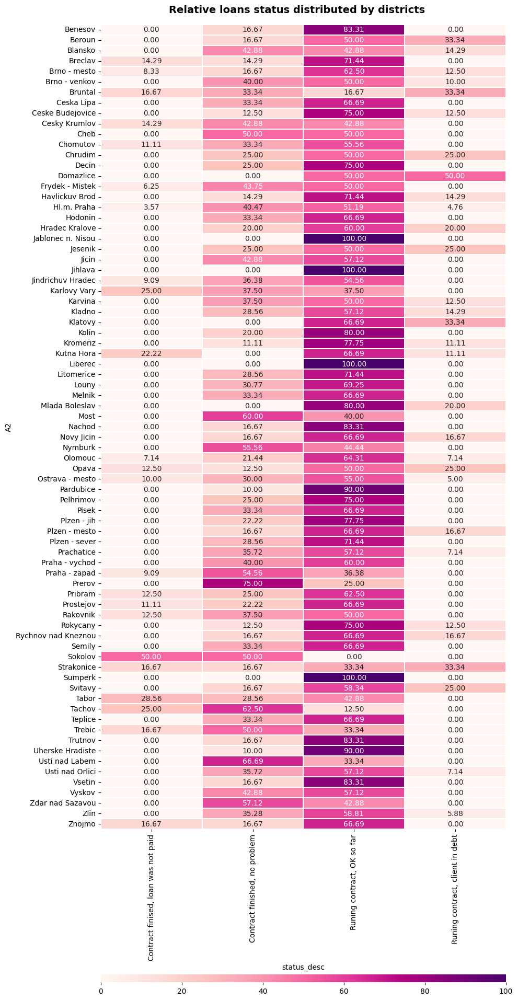

In [53]:
fig3, ax = plt.subplots(figsize=(10, 25))
fig3.subplots_adjust(top=.965)
plt.suptitle('Relative loans status distributed by districts', fontsize=14, fontweight='bold')

cbar_kws = {'orientation':"horizontal", 'pad':0.13, 'aspect':50}
sns.heatmap(dist_loan_df, annot=True, fmt='.2f', linewidths=.3, cmap='RdPu', ax=ax, cbar_kws=cbar_kws );

In [54]:
region_loan_df = loan_account_dist_df.groupby(by=['A3']).status_desc.value_counts().sort_index()
region_loan_df.head (3)

A3      status_desc                        
Prague  Contract finised, loan was not paid     3
        Contract finished, no problem          34
        Runing contract, OK so far             43
Name: status_desc, dtype: int64

In [55]:
## Manipulating the data:
region_loan_df = region_loan_df.unstack()  #Converting the groupby object into a dataset


region_loan_df.fillna(value=0.0, inplace=True)  #Replacing NaN values by zero
region_loan_df = df_row_normalize(region_loan_df)  #Normalizing its values by the total of each row

## Converting the normalized float values to percentual int values:
region_loan_df = (region_loan_df*100).astype(float).applymap('{:,.2f}'.format)#
region_loan_df.head (5)

status_desc,"Contract finised, loan was not paid","Contract finished, no problem","Runing contract, OK so far","Runing contract, client in debt"
A3,,,,
Prague,3.57,40.48,51.19,4.76
central Bohemia,5.56,28.89,60.00,5.56
east Bohemia,0.00,22.62,66.67,10.71
north Bohemia,1.64,31.15,67.21,0.00
north Moravia,5.13,29.91,54.70,10.26


In [56]:
region_loan_df = region_loan_df.astype(np.float16)
region_loan_df.dtypes
region_loan_df.head(3)

status_desc,"Contract finised, loan was not paid","Contract finished, no problem","Runing contract, OK so far","Runing contract, client in debt"
A3,,,,
Prague,3.570312,40.468750,51.1875,4.761719
central Bohemia,5.558594,28.890625,60.0000,5.558594
east Bohemia,0.000000,22.625000,66.6875,10.710938


<AxesSubplot:xlabel='status_desc', ylabel='A3'>

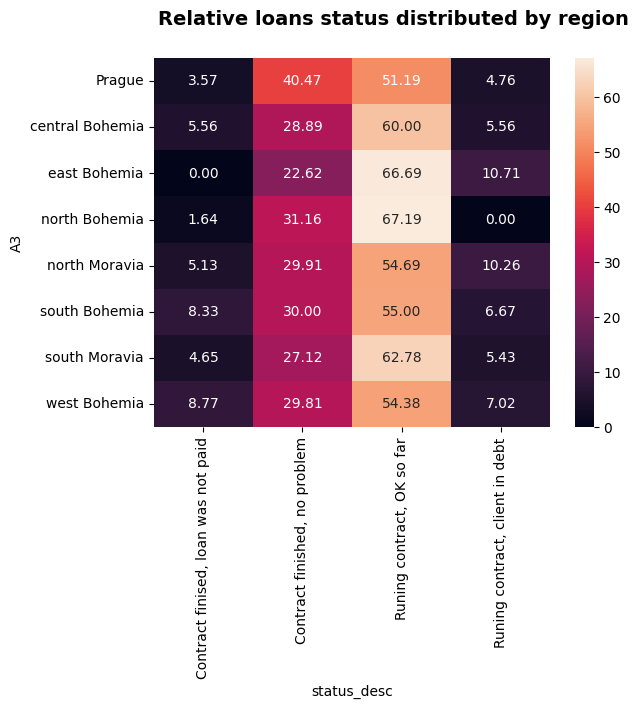

In [57]:
#fig3, ax = plt.subplots(figsize=(10, 25))
#fig3.subplots_adjust(top=.965)
plt.suptitle('Relative loans status distributed by region', fontsize=14, fontweight='bold')

#cbar_kws = {'orientation':"horizontal", 'pad':0.13, 'aspect':50}
sns.heatmap(region_loan_df, annot=True, fmt='.2f') #linewidths=.3, cmap='RdPu', ax=ax, cbar_kws=cbar_kws );

# Transcation Analysis


In [58]:
#take a look to the subset where operation values are missing

trans_opermis_df = trans_df [trans_df ['operation'].isnull ()] [trans_df.columns]
trans_opermis_df.head (3)

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account
137,3591421,1844,1993-01-31,PRIJEM,NaN,12.6,3754.6,UROK,NaN,NaN
138,3617490,2632,1993-01-31,PRIJEM,NaN,47.5,15411.5,UROK,NaN,NaN
139,3579543,1493,1993-01-31,PRIJEM,NaN,13.3,5222.3,UROK,NaN,NaN


In [59]:
#interpretation why it is missing

trans_opermis_df.groupby ('type', axis =0).count ()

,trans_id,account_id,date,operation,amount,balance,k_symbol,bank,account
type,,,,,,,,,
PRIJEM,178663,178663,178663,0,178663,178663,178663,0,0


In [60]:
trans_opermis_df.groupby ('k_symbol', axis =0).count ()

,trans_id,account_id,date,type,operation,amount,balance,bank,account
k_symbol,,,,,,,,,
UROK,178663,178663,178663,178663,0,178663,178663,0,0


In [61]:
# all null value are for intrest credited as they cannot be filled with any operation type like other case
#substituting missing value in operation with intrest_credit

trans_df ['operation'].fillna ('Intrest_credit', inplace = True)

#filling all missing values with nan
trans_df.fillna (np.NaN, inplace = True)

trans_df.isnull ().sum ()


trans_id           0
account_id         0
date               0
type               0
operation          0
amount             0
balance            0
k_symbol      478646
bank          775067
account       753573
dtype: int64

array([<AxesSubplot:title={'center':'Percentage_ratio'}>], dtype=object)

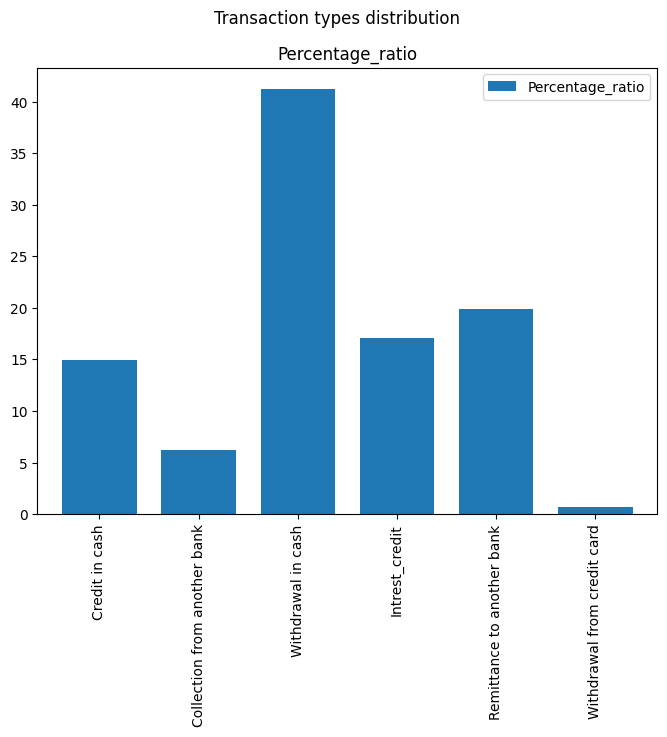

In [62]:
#transactions popularity for the whole reported period 

trans_count = Counter (trans_df ['operation'])

trans_counts = pd.DataFrame.from_dict (trans_count, orient = 'index')
trans_counts.columns = ['Percentage_ratio']
trans_counts = trans_counts / (trans_counts ['Percentage_ratio'].sum ()) * 100




trans_counts.plot (kind = 'bar',
                    title = 'Transaction types distribution',
                    width = 0.75,
                    figsize = (8, 5.8),
                    subplots = True, 
                    
                    )


In [63]:
#adding a column indicating a year when a transaction was performed 
trans_df ['trans_year'] = trans_df ['date']
trans_df ['trans_year'] = trans_df ['trans_year'].apply (year_extract)
    
trans_df.tail (3)

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year
1048572,1109971,3789,1998-12-19,Withdrawal in cash,Withdrawal in cash,4900.0,44784.0,NaN,NaN,NaN,1998
1048573,1110516,3791,1998-12-19,VYDAJ,Withdrawal in cash,23500.0,60146.1,NaN,NaN,NaN,1998
1048574,1110008,3789,1998-12-19,VYDAJ,Withdrawal in cash,11100.0,33684.0,NaN,NaN,NaN,1998


In [64]:
#grouping by tran_year and operation, then counting number of transactions  
year_trans_type_df = pd.DataFrame (trans_df.groupby (['trans_year', 'operation'], axis = 0) ['operation'].count ())

#naming column as 'count' 
year_trans_type_df.columns = ['count']

#making columns out of multi-index of tran_year and operation so to make it easier to operate with values
year_trans_type_df.reset_index (level= ['operation', 'trans_year'], inplace = True)

display (year_trans_type_df .head (50))

,trans_year,operation,count
0,1993,Collection from another bank,2462
1,1993,Credit in cash,6684
2,1993,Intrest_credit,6065
3,1993,Remittance to another bank,3231
4,1993,Withdrawal in cash,9763
5,1994,Collection from another bank,5885
6,1994,Credit in cash,13677
7,1994,Intrest_credit,16181
8,1994,Remittance to another bank,16980
9,1994,Withdrawal from credit card,65


In [65]:
#no values for Deposit in 1993 
#adding as zero

list_of_zer1 = [pd.Series ([1993, 'Withdrawal from credit card', 0], index = year_trans_type_df.columns)]
year_trans_type_df = year_trans_type_df.append (list_of_zer1, ignore_index = True)

year_trans_type_df.sort_values (['trans_year', 'operation'], inplace= True)
year_trans_type_df.reset_index (inplace = True, drop = True) #making index start from 0 again
display (year_trans_type_df .head (6))

C:\Users\Acer\AppData\Local\Temp\ipykernel_5004\2221742296.py:5: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,trans_year,operation,count
0,1993,Collection from another bank,2462
1,1993,Credit in cash,6684
2,1993,Intrest_credit,6065
3,1993,Remittance to another bank,3231
4,1993,Withdrawal from credit card,0
5,1993,Withdrawal in cash,9763


In [66]:
#plotting number of transactions per year 

x = list (year_trans_type_df ['trans_year'].unique()) #years 
y =  list (year_trans_type_df [year_trans_type_df ['operation'] == 'Collection from another bank'] ['count']) 
y2 = list (year_trans_type_df [year_trans_type_df ['operation'] == 'Credit in cash'] ['count']) 
y3 = list (year_trans_type_df [year_trans_type_df ['operation'] == 'Withdrawal from credit card'] ['count']) 
y4 = list (year_trans_type_df [year_trans_type_df ['operation'] == 'Intrest_credit'] ['count']) 
y5 = list (year_trans_type_df [year_trans_type_df ['operation'] == 'Remittance to another bank'] ['count']) 
y6 = list (year_trans_type_df [year_trans_type_df ['operation'] == 'Withdrawal in cash'] ['count']) 

bar1 = go.Bar(
    x=x,
    y=y,
    text= y,
    name = 'Collection from another bank',
    textposition = 'auto',
    marker=dict(
        color='rgb(000,000,100)',
        line=dict(
            color='rgb(8,48,107)',
            width=0.5),
        ),
    opacity=0.6
)

bar2 = go.Bar(
    x=x,
    y=y2,
    text=y2,
    name = 'Credit in cash',
    textposition = 'auto',
    marker=dict(
        color='rgb(0,100,0)',
        line=dict(
            color='rgb(8,100,107)',
            width=0.5),
        ),
    opacity=0.6
)

bar3 = go.Bar(
    x=x,
    y=y3,
    text=y3,
    name = 'Withdrawal from credit card',
    textposition = 'auto',
    marker=dict(
        color='rgb(100,000,0)',
        line=dict(
            color='rgb(8,0,50)',
            width=0.5),
        ),
    opacity=0.6
)


bar4 = go.Bar(
    x=x,
    y=y4,
    text=y4,
    name = 'Intrest_credit',
    textposition = 'auto',
    marker=dict(
        color='rgb(100,100,000)',
        line=dict(
            color='rgb(8,48,107)',
            width=0.5),
        ),
    opacity=0.6
)

bar5 = go.Bar(
    x=x,
    y=y5,
    text=y2,
    name = 'Remittance to another bank',
    textposition = 'auto',
    marker=dict(
        color='rgb(0,100,100)',
        line=dict(
            color='rgb(8,48,107)',
            width=0.5),
        ),
    opacity=0.6
)


bar6 = go.Bar(
    x=x,
    y=y6,
    text=y6,
    name = 'Withdrawal in cash',
    textposition = 'auto',
    marker=dict(
        color='rgb(100,100,100)',
        line=dict(
            color='rgb(8,48,107)',
            width=0.5),
        ),
    opacity=0.6
)

#data = [ bar3, bar5]
data = [bar1, bar2, bar3, bar4, bar5, bar6]
fig = go.Figure (data = data)
fig.show()

In [67]:
#investigating transactions marked as "collection from another bank" 

trans_col_df = trans_df [trans_df ['operation'] == 'Collection from another bank']

#unique values in the column k_symbol which will describe possible reason for collection
trans_col_df ['k_symbol'].unique ()

array(['DUCHOD', nan], dtype=object)

In [68]:
#checking proportion of each possible value: Pension ( old-age pension) and NaNs
pd.DataFrame(Counter (trans_col_df ['k_symbol']), index = [0]).transpose () / trans_col_df.shape [0] * 100


# 46.5% collection from another bank is from old_age pension
# rest is from funds transfer between clients

,0
DUCHOD,46.512127
NaN,53.487873


In [69]:
trans_col_df [trans_col_df ['k_symbol'] == 'DUCHOD'] ['amount'].sum ()



167472118.0

In [70]:
trans_col_df [trans_col_df ['k_symbol'] != 'DUCHOD'] ['amount'].sum ()

614007835.0

In [71]:
#investigating transactions marked as "remittance to another bank"
trans_rem_df = trans_df [trans_df ['operation'] == 'Remittance to another bank']

#unique values in the column k_symbol which will describe possible reason for collection
trans_rem_df ['k_symbol'].unique ()

array(['SIPO', ' ', 'POJISTNE', nan, 'UVER'], dtype=object)

In [72]:
#filling spaces in k_symbol with NaN
trans_rem_df = trans_rem_df.replace(r'^\s*$', np.nan, regex=True)

In [73]:
#checking proportion of each possible value for remittance transactions
pd.DataFrame(Counter (trans_rem_df ['k_symbol']), index = [0]).transpose () / trans_rem_df.shape [0] * 100


,0
SIPO,55.335289
NaN,29.273633
POJISTNE,8.871103
UVER,6.519975


In [74]:
#verifying positive/negative balance between collection from another banks and remittance to another banks
trans_colrem_df = trans_col_df.append (trans_rem_df)

#overall balance of incoming (PREVOD Z UCTU) and outgoing (PREVOD NA UCET)
display (pd.DataFrame (trans_colrem_df.groupby (['operation']).sum () ['amount'].sort_values ()))

#proportion 
display (pd.DataFrame (trans_colrem_df.groupby (['operation']).sum () ['amount'].sort_values ())/trans_colrem_df ['amount'].sum () *100)


C:\Users\Acer\AppData\Local\Temp\ipykernel_5004\961359832.py:2: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,amount
operation,
Remittance to another bank,672637786.3
Collection from another bank,781479953.0


,amount
operation,
Remittance to another bank,46.25745
Collection from another bank,53.74255


In [75]:
#mean of remittance and collection 
display (pd.DataFrame (trans_colrem_df.groupby (['operation']).mean () ['amount'].sort_values ()))

,amount
operation,
Remittance to another bank,3229.441607
Collection from another bank,11981.111106


In [76]:
#now let's take a look if there is any trend from 1993 to 1998 in the amounts for remittance and collection
year_transfer_df = pd.DataFrame (trans_colrem_df.groupby (['operation','trans_year'], axis = 0) ['amount'] .sum ().sort_values ())

#naming column as 'sum' 
year_transfer_df.columns = ['sum']

#making columns out of multi-index so to make it easier to operate with values
year_transfer_df.reset_index (inplace = True)


display (year_transfer_df .head (n=30))

,operation,trans_year,sum
0,Remittance to another bank,1993,10159410.7
1,Collection from another bank,1993,29809129.0
2,Remittance to another bank,1994,53841549.1
3,Collection from another bank,1994,68925764.0
4,Remittance to another bank,1995,81845324.4
5,Collection from another bank,1995,99242619.0
6,Remittance to another bank,1996,119563522.2
7,Collection from another bank,1996,146015899.0
8,Remittance to another bank,1997,182443823.2
9,Collection from another bank,1997,207339926.0


In [77]:
#plotting sum of remittance and collection per years 
x = list (year_transfer_df ['trans_year'].unique()) #years 
y =  list (year_transfer_df [year_transfer_df ['operation'] == 'Remittance to another bank'] ['sum']) 
y2 = list (year_transfer_df [year_transfer_df ['operation'] == 'Collection from another bank'] ['sum']) 

bar2 = go.Bar(
    x=x,
    y=y,
    text=y,
    name = 'Remittance to another bank',
    textposition = 'auto',
    marker=dict(
        color='rgb(0,100,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
bar5 = go.Bar(
    x=x,
    y=y2,
    text=y2,
    name = 'Collection from another bank',
    textposition = 'auto',
    marker=dict(
        color='rgb(255,215,0)',
        line=dict(
            color='rgb(8,48,107)',
            width=1.5),
        ),
    opacity=0.6
)
data = [bar2, bar5]
fig = go.Figure (data = data)
fig.show()

In [78]:
#a dataframe for plotting remittance and colletion by months distribution
trans_remcol_df = trans_colrem_df.copy ()

#columns with amounts that affects balance positively - collection from another banks 
trans_remcol_df = trans_remcol_df.assign (pos_sum = np.nan)

#columns with amounts that affects balance negatively - remittance to another banks
trans_remcol_df = trans_remcol_df.assign (neg_sum = np.nan)

#filling columns pos_sum and neg_sum based on operation type. pos_sum stands for inflows
trans_remcol_df.pos_sum = trans_remcol_df.amount.where (trans_remcol_df.operation == 'Collection from another bank', trans_remcol_df.pos_sum)

#neg_sum stands for outflows
trans_remcol_df.neg_sum = trans_remcol_df.amount.where (trans_remcol_df.operation == 'Remittance to another bank', trans_remcol_df.neg_sum )

display (trans_remcol_df.head (n=3))
trans_remcol_df [trans_remcol_df ['operation'] == 'Collection from another bank'].tail (n=3)

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year,pos_sum,neg_sum
15,637742,2177,1993-01-05,PRIJEM,Collection from another bank,5123.0,5923.0,DUCHOD,YZ,62457513.0,1993,5123.0,NaN
17,232961,793,1993-01-05,PRIJEM,Collection from another bank,3401.0,4201.0,NaN,IJ,6149286.0,1993,3401.0,NaN
21,542216,1844,1993-01-07,PRIJEM,Collection from another bank,3242.0,3742.0,NaN,ST,42988401.0,1993,3242.0,NaN


,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year,pos_sum,neg_sum
1047122,546460,1860,1998-12-14,PRIJEM,Collection from another bank,3255.0,20916.3,NaN,MN,61854898.0,1998,3255.0,NaN
1047127,605757,2062,1998-12-14,PRIJEM,Collection from another bank,64642.0,97552.6,NaN,EF,10179949.0,1998,64642.0,NaN
1047137,519257,1773,1998-12-14,PRIJEM,Collection from another bank,4316.0,17215.9,DUCHOD,CD,77385341.0,1998,4316.0,NaN


In [79]:
#we need a pandas.DateTimeIndex for resampling
trans_remcol_df.set_index (trans_remcol_df ['date'], inplace = True)
trans_remcol_df.head (n=3)


,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year,pos_sum,neg_sum
date,,,,,,,,,,,,,
1993-01-05,637742,2177,1993-01-05,PRIJEM,Collection from another bank,5123.0,5923.0,DUCHOD,YZ,62457513.0,1993,5123.0,NaN
1993-01-05,232961,793,1993-01-05,PRIJEM,Collection from another bank,3401.0,4201.0,NaN,IJ,6149286.0,1993,3401.0,NaN
1993-01-07,542216,1844,1993-01-07,PRIJEM,Collection from another bank,3242.0,3742.0,NaN,ST,42988401.0,1993,3242.0,NaN


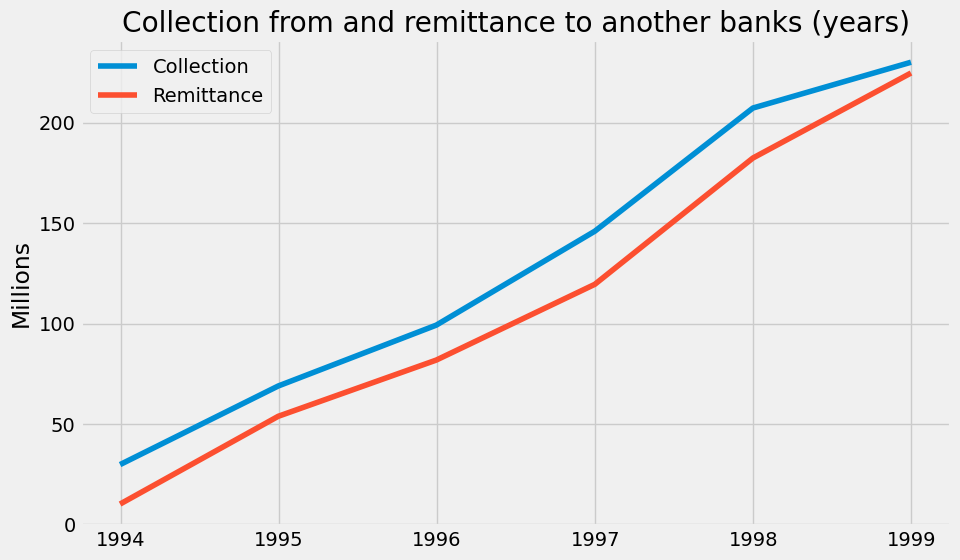

In [80]:
#plotting results with aggregation on the level of years
inflows = trans_remcol_df['pos_sum'].resample('Y').sum ()
outflows = trans_remcol_df['neg_sum'].resample('Y').sum ()

plt.style.use('fivethirtyeight')
x = outflows.index
fig, ax = plt.subplots(figsize = (10,6))
y1 = list (inflows / 1000000) 
y2 = list (outflows / 1000000)

ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Collection')
ax.plot(x, y2, label = 'Remittance' )#, figsize = (8,8))
ax.set_title("Collection from and remittance to another banks (years)")
plt.legend (loc = 'best')
plt.show()

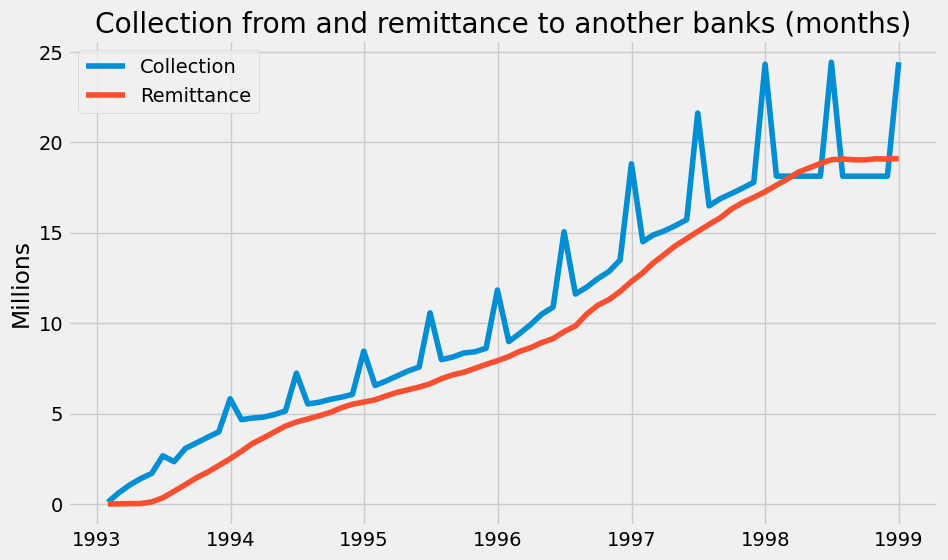

In [81]:
#plotting results with aggregation on the level of months
inflows = trans_remcol_df['pos_sum'].resample('M').sum ()
outflows = trans_remcol_df['neg_sum'].resample('M').sum ()

plt.style.use('fivethirtyeight')
x = outflows.index
fig, ax = plt.subplots(figsize = (10,6))
y1 = list (inflows / 1000000) 
y2 = list (outflows / 1000000)

ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Collection')
ax.plot(x, y2, label = 'Remittance' )#, figsize = (8,8))
ax.set_title("Collection from and remittance to another banks (months)")
plt.legend (loc = 'best')
plt.show()

In [82]:
#complementing trans_df with account data and district data
trans_acc_df = trans_df.copy ()
trans_acc_df = trans_acc_df.merge (account_df, left_on = 'account_id', right_on = 'account_id', 
                                           how = 'left', validate = 'many_to_one') 
trans_acc_dist_df = trans_acc_df.merge (district_df, left_on = 'district_id', right_on = 'A1', 
                                           how = 'left', validate = 'many_to_one')
display (trans_df.head (3))
display (trans_acc_df.head (3)) 
display (trans_acc_dist_df.head (3))

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year
0,695247,2378,1993-01-01,PRIJEM,Credit in cash,700.0,700.0,NaN,NaN,NaN,1993
1,171812,576,1993-01-01,PRIJEM,Credit in cash,900.0,900.0,NaN,NaN,NaN,1993
2,207264,704,1993-01-01,PRIJEM,Credit in cash,1000.0,1000.0,NaN,NaN,NaN,1993


,trans_id,account_id,date_x,type,operation,amount,balance,k_symbol,bank,account,trans_year,district_id,frequency,date_y
0,695247,2378,1993-01-01,PRIJEM,Credit in cash,700.0,700.0,NaN,NaN,NaN,1993,16,Monthly fee,1993-01-01
1,171812,576,1993-01-01,PRIJEM,Credit in cash,900.0,900.0,NaN,NaN,NaN,1993,55,Monthly fee,1993-01-01
2,207264,704,1993-01-01,PRIJEM,Credit in cash,1000.0,1000.0,NaN,NaN,NaN,1993,55,Monthly fee,1993-01-01


,trans_id,account_id,date_x,type,operation,amount,balance,k_symbol,bank,account,...,A7,A8,A9,A10,A11,A12,A13,A14,A15,A16
0,695247,2378,1993-01-01,PRIJEM,Credit in cash,700.0,700.0,NaN,NaN,NaN,...,10,1,8,56.9,8427,1.12,1.54,107,1874,1913
1,171812,576,1993-01-01,PRIJEM,Credit in cash,900.0,900.0,NaN,NaN,NaN,...,18,0,9,33.9,8743,1.88,2.43,111,3659,3894
2,207264,704,1993-01-01,PRIJEM,Credit in cash,1000.0,1000.0,NaN,NaN,NaN,...,18,0,9,33.9,8743,1.88,2.43,111,3659,3894


In [83]:
trans_bal_df = trans_df.copy ()

#column with amounts that affects balance positively 
trans_bal_df = trans_bal_df.assign (pos_sum = np.nan)

#column with amounts that affects balance negatively 
trans_bal_df = trans_bal_df.assign (neg_sum = np.nan)

#filling columns pos_sum and neg_sum based on operation type. pos_sum stands for inflows
trans_bal_df.pos_sum = trans_bal_df.amount.where (trans_bal_df.operation == 'Credit in cash', trans_bal_df.pos_sum )
trans_bal_df.pos_sum = trans_bal_df.amount.where (trans_bal_df.operation == 'Collection from another bank', trans_bal_df.pos_sum)

#neg_sum stands for outflows
trans_bal_df.neg_sum = trans_bal_df.amount.where (trans_bal_df.operation == 'Withdrawal in cash', trans_bal_df.neg_sum )
trans_bal_df.neg_sum = trans_bal_df.amount.where (trans_bal_df.operation == 'Remittance to another bank', trans_bal_df.neg_sum )
trans_bal_df.neg_sum = trans_bal_df.amount.where (trans_bal_df.operation == 'Withdrawal from credit card', trans_bal_df.neg_sum )

trans_bal_df [trans_bal_df ['operation'] == 'Withdrawal in cash'].tail (n=3)

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year,pos_sum,neg_sum
1048572,1109971,3789,1998-12-19,Withdrawal in cash,Withdrawal in cash,4900.0,44784.0,NaN,NaN,NaN,1998,NaN,4900.0
1048573,1110516,3791,1998-12-19,VYDAJ,Withdrawal in cash,23500.0,60146.1,NaN,NaN,NaN,1998,NaN,23500.0
1048574,1110008,3789,1998-12-19,VYDAJ,Withdrawal in cash,11100.0,33684.0,NaN,NaN,NaN,1998,NaN,11100.0


In [84]:
#setting date as index for further visualization
trans_bal_df.set_index (trans_bal_df ['date'], inplace = True)
trans_bal_df.head (n=3)

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year,pos_sum,neg_sum
date,,,,,,,,,,,,,
1993-01-01,695247,2378,1993-01-01,PRIJEM,Credit in cash,700.0,700.0,NaN,NaN,NaN,1993,700.0,NaN
1993-01-01,171812,576,1993-01-01,PRIJEM,Credit in cash,900.0,900.0,NaN,NaN,NaN,1993,900.0,NaN
1993-01-01,207264,704,1993-01-01,PRIJEM,Credit in cash,1000.0,1000.0,NaN,NaN,NaN,1993,1000.0,NaN


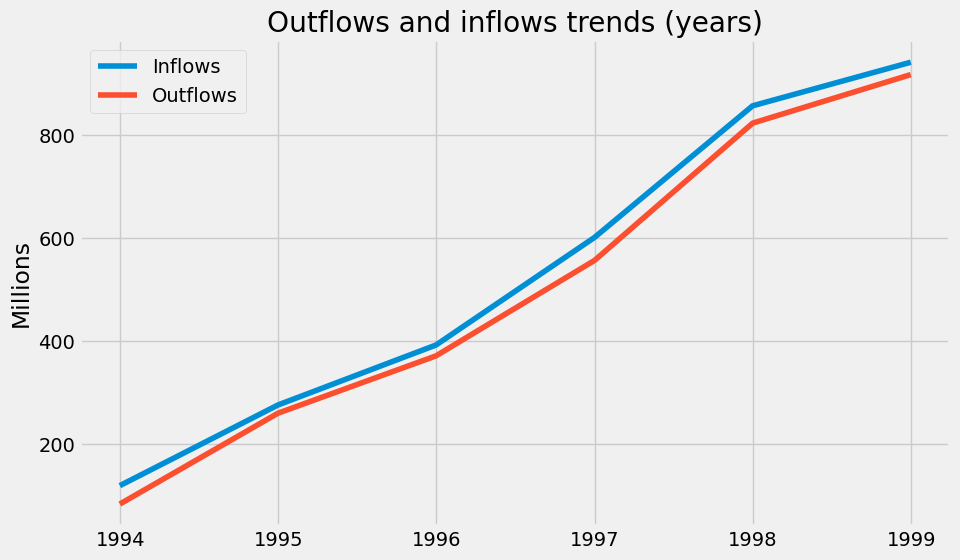

In [85]:
#Outflows and inflows trends - years aggregation
inflows = trans_bal_df['pos_sum'].resample('Y').sum ()
outflows = trans_bal_df['neg_sum'].resample('Y').sum ()

plt.style.use('fivethirtyeight')
x = outflows.index
fig, ax = plt.subplots(figsize = (10,6))
y1 = list (inflows / 1000000) 
y2 = list (outflows / 1000000)
ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Inflows')
ax.plot(x, y2, label = 'Outflows' )#, figsize = (8,8))
ax.set_title("Outflows and inflows trends (years)")
plt.legend (loc = 'best')
plt.show()

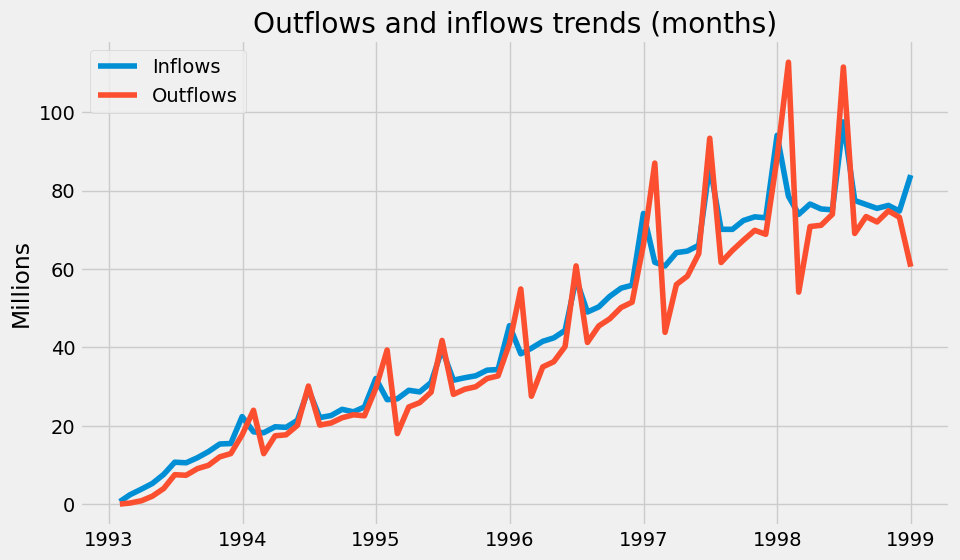

In [86]:
#Outflows and inflows trends - months aggregation
inflows = trans_bal_df['pos_sum'].resample('M').sum ()
outflows = trans_bal_df['neg_sum'].resample('M').sum ()

plt.style.use('fivethirtyeight')
x = outflows.index
fig, ax = plt.subplots(figsize = (10,6))
y1 = list (inflows / 1000000) 
y2 = list (outflows / 1000000)
ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Inflows')
ax.plot(x, y2, label = 'Outflows' )#, figsize = (8,8))
ax.set_title("Outflows and inflows trends (months)")
plt.legend (loc = 'best')
plt.show()

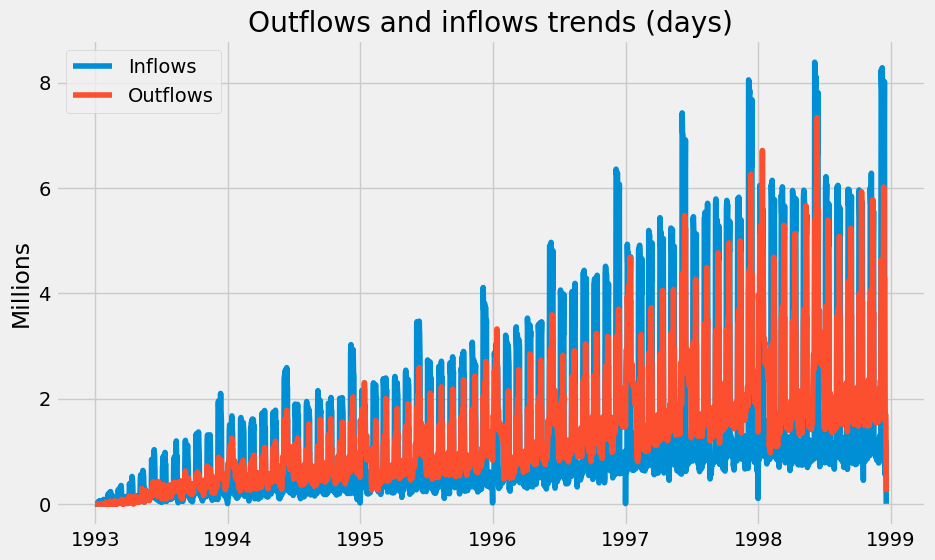

In [87]:
#Outflows and inflows trends - days aggregation
inflows = trans_bal_df['pos_sum'].resample('D').sum ()
outflows = trans_bal_df['neg_sum'].resample('D').sum ()

plt.style.use('fivethirtyeight')
x = outflows.index
fig, ax = plt.subplots(figsize = (10,6))
y1 = list (inflows / 1000000) 
y2 = list (outflows / 1000000)
ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Inflows')
ax.plot(x, y2, label = 'Outflows' )#, figsize = (8,8))
ax.set_title("Outflows and inflows trends (days)")
plt.legend (loc = 'best')
plt.show()

In [88]:
#verifying overall balance of inflows and outflows for the whole reported period
display (trans_bal_df['neg_sum'].sum ())
display (trans_bal_df['pos_sum'].sum ())

3014413814.0999994

3189638250.0

In [89]:
#Outflows details investigation

trans_negflow_df = trans_df.copy ()

#column with amounts that stand for cash withdrawal 
trans_negflow_df = trans_negflow_df.assign (cw_sum = np.nan)

#column with amounts that stand for withdrawal from credit card 
trans_negflow_df = trans_negflow_df.assign (cwc_sum = np.nan)

#column with amounts that stand for remittance to another banks 
trans_negflow_df = trans_negflow_df.assign (rem_sum = np.nan)

#filling columns pos_sum and neg_sum based on operation type. pos_sum stands for inflows
trans_negflow_df.cw_sum = trans_negflow_df.amount.where (trans_negflow_df.operation == 'Withdrawal in cash', trans_negflow_df.cw_sum )
trans_negflow_df.cwc_sum = trans_negflow_df.amount.where (trans_negflow_df.operation == 'Withdrawal from credit card', trans_negflow_df.cwc_sum)
trans_negflow_df.rem_sum = trans_negflow_df.amount.where (trans_negflow_df.operation == 'Remittance to another bank', trans_negflow_df.rem_sum)

#trans_negflow_df [trans_negflow_df ['operation'] == 'PREVOD NA UCET'].head (n=5)

In [90]:
#setting date as index for further visualization
trans_negflow_df.set_index (trans_negflow_df ['date'], inplace = True)
trans_negflow_df.head (n=3)

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year,cw_sum,cwc_sum,rem_sum
date,,,,,,,,,,,,,,
1993-01-01,695247,2378,1993-01-01,PRIJEM,Credit in cash,700.0,700.0,NaN,NaN,NaN,1993,NaN,NaN,NaN
1993-01-01,171812,576,1993-01-01,PRIJEM,Credit in cash,900.0,900.0,NaN,NaN,NaN,1993,NaN,NaN,NaN
1993-01-01,207264,704,1993-01-01,PRIJEM,Credit in cash,1000.0,1000.0,NaN,NaN,NaN,1993,NaN,NaN,NaN


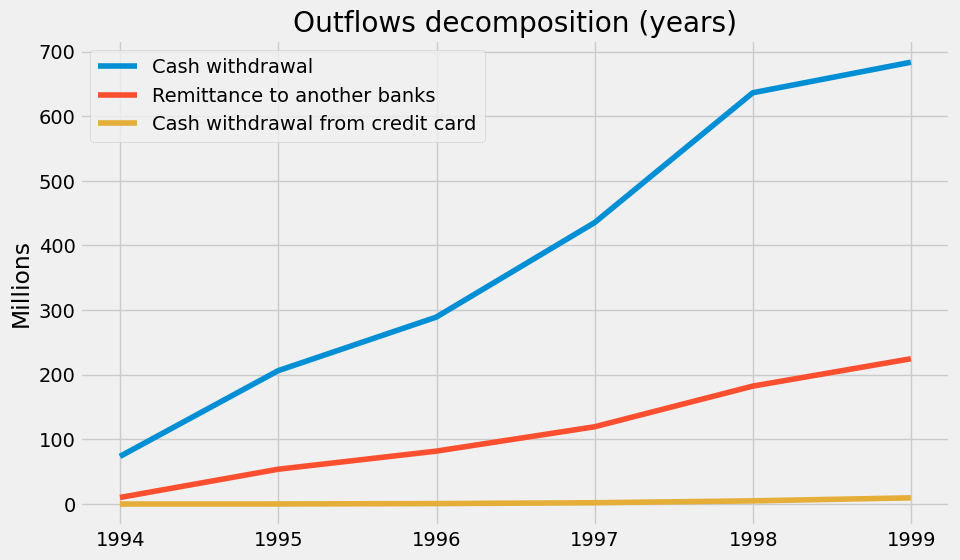

In [91]:
cashw = trans_negflow_df['cw_sum'].resample('Y').sum ()
cashw_card = trans_negflow_df['cwc_sum'].resample('Y').sum ()
remit = trans_negflow_df['rem_sum'].resample('Y').sum ()

plt.style.use('fivethirtyeight')
x = cashw.index
fig, ax = plt.subplots(figsize = (10,6))
y1 = list (cashw / 1000000) 
y2 = list (remit / 1000000)
y3 = list (cashw_card / 1000000)
ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Cash withdrawal')
ax.plot(x, y2, label = 'Remittance to another banks' )#, figsize = (8,8))
ax.plot(x, y3, label = 'Cash withdrawal from credit card' )#, figsize = (8,8))
ax.set_title("Outflows decomposition (years)")
plt.legend (loc = 'best')
plt.show()

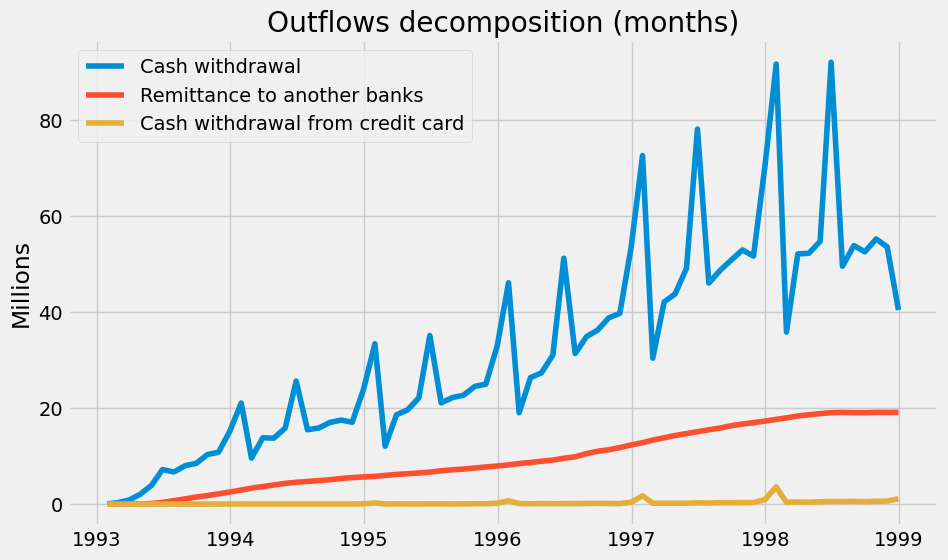

In [92]:
#plotting results outflows decomposition (months)
cashw = trans_negflow_df['cw_sum'].resample('M').sum ()
cashw_card = trans_negflow_df['cwc_sum'].resample('M').sum ()
remit = trans_negflow_df['rem_sum'].resample('M').sum ()

plt.style.use('fivethirtyeight')
x = cashw.index
fig, ax = plt.subplots(figsize = (10,6))
y1 = list (cashw / 1000000) 
y2 = list (remit / 1000000)
y3 = list (cashw_card / 1000000)
ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Cash withdrawal')
ax.plot(x, y2, label = 'Remittance to another banks' )#, figsize = (8,8))
ax.plot(x, y3, label = 'Cash withdrawal from credit card' )#, figsize = (8,8))
ax.set_title("Outflows decomposition (months)")
plt.legend (loc = 'best')
plt.show()

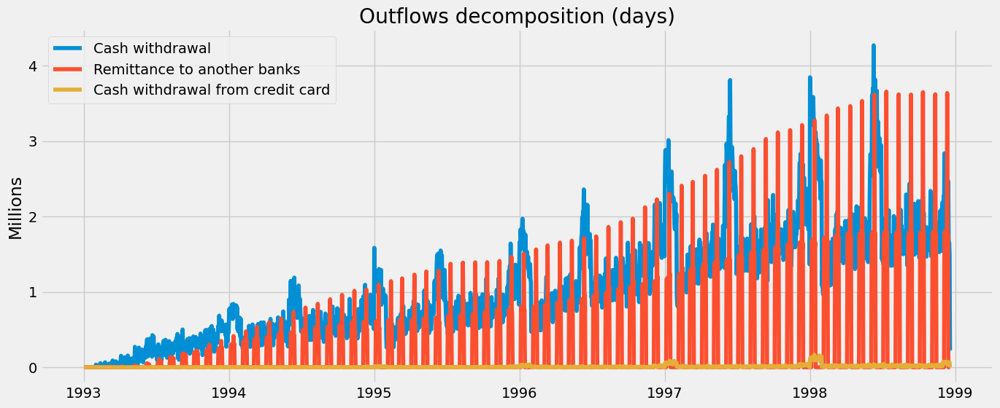

In [93]:
#plotting results outflows decomposition (days)
cashw = trans_negflow_df['cw_sum'].resample('D').sum ()
cashw_card = trans_negflow_df['cwc_sum'].resample('D').sum ()
remit = trans_negflow_df['rem_sum'].resample('D').sum ()

plt.style.use('fivethirtyeight')
x = cashw.index
fig, ax = plt.subplots(figsize = (15,6))
y1 = list (cashw / 1000000) 
y2 = list (remit / 1000000)
y3 = list (cashw_card / 1000000)
ax.set_ylabel('Millions')
ax.plot(x, y1, label = 'Cash withdrawal')
ax.plot(x, y2, label = 'Remittance to another banks' )#, figsize = (8,8))
ax.plot(x, y3, label = 'Cash withdrawal from credit card' )#, figsize = (8,8))
ax.set_title("Outflows decomposition (days)")
plt.legend (loc = 'best')
plt.show()

In [94]:
trans_df.tail()

,trans_id,account_id,date,type,operation,amount,balance,k_symbol,bank,account,trans_year
1048570,1106561,3779,1998-12-19,VYDAJ,Withdrawal in cash,12200.0,59783.7,NaN,NaN,NaN,1998
1048571,1109169,3787,1998-12-19,VYDAJ,Withdrawal in cash,2600.0,81497.4,NaN,NaN,NaN,1998
1048572,1109971,3789,1998-12-19,Withdrawal in cash,Withdrawal in cash,4900.0,44784.0,NaN,NaN,NaN,1998
1048573,1110516,3791,1998-12-19,VYDAJ,Withdrawal in cash,23500.0,60146.1,NaN,NaN,NaN,1998
1048574,1110008,3789,1998-12-19,VYDAJ,Withdrawal in cash,11100.0,33684.0,NaN,NaN,NaN,1998


# Customer Profiling

In [154]:
quantiles= pd.qcut(loan_df['duration'],4, labels=False)
loan_df = loan_df.assign(quantile_duration=quantiles.values)

quantiles= pd.qcut(loan_df['amount'],4, labels=False)
loan_df = loan_df.assign(quantile_amount=quantiles.values)

In [155]:
loan_df ['status_desc'] = loan_df ['status']


#encoding bad loans as 1 and good ones as -1 
dict =  {'A':1, 
      'B':-1,
      'C':1,
      'D':1
     }
loan_df.status= loan_df.status.replace (dict)
display (loan_df.head (5))

,loan_id,account_id,date,amount,duration,payments,status,quantile_duration,quantile_amount,status_desc
0,5314,1787,1993-07-05,96396,12,8033,-1,0,1,-1
1,5316,1801,1993-07-11,165960,36,4610,1,1,2,1
2,6863,9188,1993-07-28,127080,60,2118,1,3,2,1
3,5325,1843,1993-08-03,105804,36,2939,1,1,1,1
4,7240,11013,1993-09-06,274740,60,4579,1,3,3,1


In [156]:
loan_df.drop(columns = ['status_desc'], inplace = True)

In [157]:
loan_account_df = loan_df.copy ()
loan_account_df = loan_account_df.merge (account_df, left_on = 'account_id', right_on = 'account_id', 
                                           how = 'outer', validate = 'many_to_one')

In [158]:
loan_account_df.fillna(0, inplace = True)

In [159]:
loan_account_df['loan_account'] = loan_account_df['loan_id']
for ids, item in enumerate (loan_account_df ['loan_id']):
    if item  == 0:
        loan_account_df.loc [ids, 'loan_account'] = 0 
        
    else: 
       loan_account_df.loc [ids, 'loan_account'] = 1

In [160]:
loan_account_disposition_df = loan_account_df.merge (dis_df, left_on = 'account_id', right_on = 'account_id', 
                                           how = 'outer')

In [161]:
loan_account_disposition_card_df = loan_account_disposition_df.merge (card_df, left_on = 'disp_id', right_on = 'disp_id', 
                                           how = 'outer')

In [162]:
loan_account_disposition_card_df.fillna(0, inplace = True)

loan_account_disposition_card_df['card_holding'] = loan_account_disposition_card_df['card_id']
for ids, item in enumerate (loan_account_disposition_card_df['card_id']):
    if item  == 0:
       loan_account_disposition_card_df.loc [ids, 'card_holding'] = 0 
        
    else: 
       loan_account_disposition_card_df.loc [ids, 'card_holding'] = 1

In [163]:
loan_account_disposition_card_df['transcation_frequency'] = loan_account_disposition_card_df['account_id']
for ids, item in enumerate (loan_account_disposition_card_df['account_id']):
    if item  == 'Fee per week':
       loan_account_disposition_card_df.loc [ids, 'transcation_frequency'] = 0
        
    elif item =='Monthly fee': 
       loan_account_disposition_card_df.loc [ids, 'transcation_frequency'] = 1
    else:
        loan_account_disposition_card_df.loc[ids, 'transcation_frequency']= 2

In [164]:
loan_account_disposition_card_order_df = loan_account_disposition_card_df.merge (order_df, left_on = 'account_id', right_on = 'account_id', 
                                           how = 'outer')
loan_account_disposition_card_order_df .tail (20)

,loan_id,account_id,date_x,amount_x,duration,payments,status,quantile_duration,quantile_amount,district_id,...,card_id,type_y,issued,card_holding,transcation_frequency,order_id,bank_to,account_to,amount_y,k_symbol
8657,0.0,3934,0,0.0,0.0,0.0,0.0,0.0,0.0,6,...,0.0,0,0,0.0,2,35199.0,MN,96072834.0,2396.0,SIPO
8658,0.0,1983,0,0.0,0.0,0.0,0.0,0.0,0.0,54,...,0.0,0,0,0.0,2,NaN,NaN,NaN,NaN,NaN
8659,0.0,727,0,0.0,0.0,0.0,0.0,0.0,0.0,35,...,0.0,0,0,0.0,2,NaN,NaN,NaN,NaN,NaN
8660,0.0,3048,0,0.0,0.0,0.0,0.0,0.0,0.0,74,...,0.0,0,0,0.0,2,33913.0,UV,57049596.0,4631.2,LEASING
8661,0.0,3025,0,0.0,0.0,0.0,0.0,0.0,0.0,25,...,0.0,0,0,0.0,2,33880.0,EF,14488661.0,3354.0,SIPO
8662,0.0,906,0,0.0,0.0,0.0,0.0,0.0,0.0,59,...,0.0,0,0,0.0,2,30732.0,AB,85822999.0,2240.0,SIPO
8663,0.0,845,0,0.0,0.0,0.0,0.0,0.0,0.0,14,...,169.0,classic,980810 00:00:00,1.0,2,30629.0,IJ,33191889.0,9651.0,SIPO
8664,0.0,124,0,0.0,0.0,0.0,0.0,0.0,0.0,55,...,0.0,0,0,0.0,2,29605.0,IJ,11366123.0,447.0,SIPO
8665,0.0,124,0,0.0,0.0,0.0,0.0,0.0,0.0,55,...,0.0,0,0,0.0,2,29606.0,OP,51247948.0,575.0,
8666,0.0,124,0,0.0,0.0,0.0,0.0,0.0,0.0,55,...,0.0,0,0,0.0,2,29607.0,OP,34663748.0,971.0,INSURANCE COMPANY


In [165]:
loan_account_disposition_card_order_df['standing_order'] = loan_account_disposition_card_order_df['account_id']
for ids, item in enumerate (loan_account_disposition_card_order_df['standing_order']):
    if item  == 0:
       loan_account_disposition_card_order_df.loc [ids, 'standing_order'] = 0
        
    else:
       loan_account_disposition_card_order_df.loc [ids, 'standing_order'] = 1

In [166]:
loan_account_disposition_card_order_client_df =loan_account_disposition_card_order_df.merge (client_df, left_on = 'client_id', right_on = 'client_id', 
                                           how = 'outer')

In [167]:
final_df = loan_account_disposition_card_order_client_df
final_df.head(10)

,loan_id,account_id,date_x,amount_x,duration,payments,status,quantile_duration,quantile_amount,district_id_x,...,bank_to,account_to,amount_y,k_symbol,standing_order,birth_number,district_id_y,birth_date,gender,age
0,5314.0,1787,1993-07-05 00:00:00,96396.0,12.0,8033.0,-1.0,0.0,1.0,30,...,EF,8468449.0,8033.2,CREDIT,1,475722,30,1947-07-22,0.0,51
1,5316.0,1801,1993-07-11 00:00:00,165960.0,36.0,4610.0,1.0,1.0,2.0,46,...,OP,33671474.0,4610.0,CREDIT,1,680722,46,1968-07-22,1.0,30
2,5316.0,1801,1993-07-11 00:00:00,165960.0,36.0,4610.0,1.0,1.0,2.0,46,...,QR,49547737.0,4167.0,SIPO,1,680722,46,1968-07-22,1.0,30
3,5316.0,1801,1993-07-11 00:00:00,165960.0,36.0,4610.0,1.0,1.0,2.0,46,...,YZ,80957543.0,3419.0,,1,680722,46,1968-07-22,1.0,30
4,5316.0,1801,1993-07-11 00:00:00,165960.0,36.0,4610.0,1.0,1.0,2.0,46,...,AB,73968469.0,956.0,INSURANCE COMPANY,1,680722,46,1968-07-22,1.0,30
5,6863.0,9188,1993-07-28 00:00:00,127080.0,60.0,2118.0,1.0,3.0,2.0,45,...,GH,22466057.0,2118.3,CREDIT,1,360602,45,1936-06-02,1.0,62
6,6863.0,9188,1993-07-28 00:00:00,127080.0,60.0,2118.0,1.0,3.0,2.0,45,...,OP,94166147.0,7936.0,SIPO,1,360602,45,1936-06-02,1.0,62
7,6863.0,9188,1993-07-28 00:00:00,127080.0,60.0,2118.0,1.0,3.0,2.0,45,...,GH,11309677.0,471.0,,1,360602,45,1936-06-02,1.0,62
8,6863.0,9188,1993-07-28 00:00:00,127080.0,60.0,2118.0,1.0,3.0,2.0,45,...,OP,96138745.0,66.0,INSURANCE COMPANY,1,360602,45,1936-06-02,1.0,62
9,5325.0,1843,1993-08-03 00:00:00,105804.0,36.0,2939.0,1.0,1.0,1.0,12,...,QR,70984434.0,2938.7,CREDIT,1,405420,14,1940-04-20,0.0,58


In [168]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8677 entries, 0 to 8676
Data columns (total 32 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   loan_id                8677 non-null   float64       
 1   account_id             8677 non-null   int64         
 2   date_x                 8677 non-null   object        
 3   amount_x               8677 non-null   float64       
 4   duration               8677 non-null   float64       
 5   payments               8677 non-null   float64       
 6   status                 8677 non-null   float64       
 7   quantile_duration      8677 non-null   float64       
 8   quantile_amount        8677 non-null   float64       
 9   district_id_x          8677 non-null   int64         
 10  frequency              8677 non-null   object        
 11  date_y                 8677 non-null   datetime64[ns]
 12  loan_account           8677 non-null   float64       
 13  dis

In [169]:
final_df.drop(columns = ['loan_id','date_x','district_id_y','birth_number','k_symbol','amount_y','account_to','bank_to','order_id','issued','type_x','disp_id','date_y'], inplace = True)

In [170]:
final_df.drop_duplicates(subset=None, keep='first', inplace= True)

In [171]:
final_df.drop(columns = ['frequency'] ,inplace = True)

In [172]:
final_df.drop_duplicates(subset= ['account_id'], keep='first', inplace= True)

In [173]:
final_df.reset_index (inplace = True)

In [174]:
final_df.head(20)

,index,account_id,amount_x,duration,payments,status,quantile_duration,quantile_amount,district_id_x,loan_account,client_id,card_id,type_y,card_holding,transcation_frequency,standing_order,birth_date,gender,age
0,0,1787,96396.0,12.0,8033.0,-1.0,0.0,1.0,30,1.0,2166,0.0,0,0.0,2,1,1947-07-22,0.0,51
1,1,1801,165960.0,36.0,4610.0,1.0,1.0,2.0,46,1.0,2181,0.0,0,0.0,2,1,1968-07-22,1.0,30
2,5,9188,127080.0,60.0,2118.0,1.0,3.0,2.0,45,1.0,11314,0.0,0,0.0,2,1,1936-06-02,1.0,62
3,9,1843,105804.0,36.0,2939.0,1.0,1.0,1.0,12,1.0,2235,352.0,classic,1.0,2,1,1940-04-20,0.0,58
4,11,11013,274740.0,60.0,4579.0,1.0,3.0,3.0,1,1.0,13539,1223.0,junior,1.0,2,1,1978-09-07,1.0,20
5,14,8261,87840.0,24.0,3660.0,1.0,0.0,1.0,13,1.0,10200,0.0,0,0.0,2,1,1980-02-16,0.0,18
6,24,11265,52788.0,12.0,4399.0,1.0,0.0,0.0,15,1.0,13845,0.0,0,0.0,2,1,1973-02-16,1.0,25
7,27,5428,174744.0,24.0,7281.0,-1.0,0.0,2.0,24,1.0,6551,0.0,0,0.0,2,1,1948-08-12,0.0,50
8,28,10973,154416.0,48.0,3217.0,1.0,2.0,2.0,18,1.0,13490,0.0,0,0.0,2,1,1969-05-25,0.0,29
9,29,4894,117024.0,24.0,4876.0,1.0,0.0,2.0,14,1.0,5911,814.0,classic,1.0,2,1,1935-10-03,1.0,63


In [175]:
final_df.drop(columns = ['index'], inplace = True)

In [176]:
final_df['mean'] = final_df['account_id']
for ind in final_df.index:
    final_df['mean'][ind] = final_df['status'][ind] + 2* final_df['loan_account'][ind] + final_df['quantile_duration'][ind] + 3* final_df['quantile_amount'][ind] + 3*final_df['card_holding'][ind] + 2* final_df['standing_order'][ind] + 3*final_df['transcation_frequency'][ind]     

C:\Users\Acer\AppData\Local\Temp\ipykernel_5004\3620564135.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [177]:
final_df['quartile'] = final_df['account_id']
for ind in final_df.index:
    if (final_df['mean'][ind] < 12):
        final_df['quartile'][ind] = '4'
        
    elif (final_df['mean'][ind] > 11 and final_df['mean'][ind] < 17  ):
        final_df['quartile'][ind] = '3'
          
    elif (final_df['mean'][ind] < 22 and final_df['mean'][ind] > 16):
        final_df['quartile'][ind] = '2'
          
    else:
        final_df['quartile'][ind] = '1'

C:\Users\Acer\AppData\Local\Temp\ipykernel_5004\3471641026.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [178]:
final_df.head(20)

,account_id,amount_x,duration,payments,status,quantile_duration,quantile_amount,district_id_x,loan_account,client_id,card_id,type_y,card_holding,transcation_frequency,standing_order,birth_date,gender,age,mean,quartile
0,1787,96396.0,12.0,8033.0,-1.0,0.0,1.0,30,1.0,2166,0.0,0,0.0,2,1,1947-07-22,0.0,51,12,3
1,1801,165960.0,36.0,4610.0,1.0,1.0,2.0,46,1.0,2181,0.0,0,0.0,2,1,1968-07-22,1.0,30,18,2
2,9188,127080.0,60.0,2118.0,1.0,3.0,2.0,45,1.0,11314,0.0,0,0.0,2,1,1936-06-02,1.0,62,20,2
3,1843,105804.0,36.0,2939.0,1.0,1.0,1.0,12,1.0,2235,352.0,classic,1.0,2,1,1940-04-20,0.0,58,18,2
4,11013,274740.0,60.0,4579.0,1.0,3.0,3.0,1,1.0,13539,1223.0,junior,1.0,2,1,1978-09-07,1.0,20,26,1
5,8261,87840.0,24.0,3660.0,1.0,0.0,1.0,13,1.0,10200,0.0,0,0.0,2,1,1980-02-16,0.0,18,14,3
6,11265,52788.0,12.0,4399.0,1.0,0.0,0.0,15,1.0,13845,0.0,0,0.0,2,1,1973-02-16,1.0,25,11,4
7,5428,174744.0,24.0,7281.0,-1.0,0.0,2.0,24,1.0,6551,0.0,0,0.0,2,1,1948-08-12,0.0,50,15,3
8,10973,154416.0,48.0,3217.0,1.0,2.0,2.0,18,1.0,13490,0.0,0,0.0,2,1,1969-05-25,0.0,29,19,2
9,4894,117024.0,24.0,4876.0,1.0,0.0,2.0,14,1.0,5911,814.0,classic,1.0,2,1,1935-10-03,1.0,63,20,2


In [179]:
final_quartiledf = pd.DataFrame (final_df.groupby (['quartile'], axis = 0) ['quartile'].count ())
final_quartiledf.columns = ['Customer Count']

In [180]:
final_quartiledf.head()

,Customer Count
quartile,
1,162
2,231
3,193
4,3914


# Clustering

In [182]:
final_df.drop(columns = ['duration','payments','quantile_duration','district_id_x','card_id','birth_date'], inplace = True)

In [183]:
final_df.drop(columns = ['quantile_amount','mean','quartile',], inplace = True, )

In [184]:
final_df.head(20)

,account_id,amount_x,status,loan_account,client_id,type_y,card_holding,transcation_frequency,standing_order,gender,age
0,1787,96396.0,-1.0,1.0,2166,0,0.0,2,1,0.0,51
1,1801,165960.0,1.0,1.0,2181,0,0.0,2,1,1.0,30
2,9188,127080.0,1.0,1.0,11314,0,0.0,2,1,1.0,62
3,1843,105804.0,1.0,1.0,2235,classic,1.0,2,1,0.0,58
4,11013,274740.0,1.0,1.0,13539,junior,1.0,2,1,1.0,20
5,8261,87840.0,1.0,1.0,10200,0,0.0,2,1,0.0,18
6,11265,52788.0,1.0,1.0,13845,0,0.0,2,1,1.0,25
7,5428,174744.0,-1.0,1.0,6551,0,0.0,2,1,0.0,50
8,10973,154416.0,1.0,1.0,13490,0,0.0,2,1,0.0,29
9,4894,117024.0,1.0,1.0,5911,classic,1.0,2,1,1.0,63


In [185]:
trans_df1 = trans_df.copy()

In [186]:
trans_df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4500 entries, 0 to 724946
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   account_id  4500 non-null   int64  
 1   type        4500 non-null   object 
 2   operation   4500 non-null   object 
 3   amount      4500 non-null   float64
 4   balance     4500 non-null   float64
dtypes: float64(2), int64(1), object(2)
memory usage: 210.9+ KB


In [187]:
trans_df.drop(columns = ['k_symbol','bank','account','trans_year','date','trans_id'], inplace = True)

KeyError: "['k_symbol', 'bank', 'account', 'trans_year', 'date', 'trans_id'] not found in axis"

In [188]:
trans_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4500 entries, 0 to 724946
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   account_id  4500 non-null   int64  
 1   type        4500 non-null   object 
 2   operation   4500 non-null   object 
 3   amount      4500 non-null   float64
 4   balance     4500 non-null   float64
dtypes: float64(2), int64(1), object(2)
memory usage: 210.9+ KB


In [189]:
trans_df.drop_duplicates(subset= ['account_id'], keep='first', inplace= True)

In [190]:
final_df = final_df.merge (trans_df, left_on = 'account_id', right_on = 'account_id', 
                                           how = 'outer', validate = 'many_to_one')

In [200]:
#final_df.fillna(0, inplace = True)
final_df.head(10)

,amount_x,status,loan_account,client_id,card_holding,transcation_frequency,standing_order,gender,age,type,operation,amount,balance
0,96396.0,-1.0,1.0,2166,0.0,2,1,0.0,51,PRIJEM,Credit in cash,1100.0,1100.0
1,165960.0,1.0,1.0,2181,0.0,2,1,1.0,30,PRIJEM,Credit in cash,700.0,700.0
2,127080.0,1.0,1.0,11314,0.0,2,1,1.0,62,PRIJEM,Credit in cash,800.0,800.0
3,105804.0,1.0,1.0,2235,1.0,2,1,0.0,58,PRIJEM,Credit in cash,1000.0,1000.0
4,274740.0,1.0,1.0,13539,1.0,2,1,1.0,20,PRIJEM,Credit in cash,600.0,600.0
5,87840.0,1.0,1.0,10200,0.0,2,1,0.0,18,PRIJEM,Credit in cash,500.0,500.0
6,52788.0,1.0,1.0,13845,0.0,2,1,1.0,25,PRIJEM,Credit in cash,1000.0,1000.0
7,174744.0,-1.0,1.0,6551,0.0,2,1,0.0,50,PRIJEM,Credit in cash,1000.0,1000.0
8,154416.0,1.0,1.0,13490,0.0,2,1,0.0,29,PRIJEM,Credit in cash,8897.0,8897.0
9,117024.0,1.0,1.0,5911,1.0,2,1,1.0,63,PRIJEM,Credit in cash,800.0,800.0


In [210]:
#final_df.drop(columns = ['type','operation'], inplace = True)
df = final_df

# Elbow Method

In [202]:
scaler = StandardScaler()
df_scaled=sc.fit_transform(final_df)

In [204]:
WCSS=[]
for i in range(1,20):
    cluster_kmeans=KMeans(n_clusters=i,init="k-means++",random_state=0)
    cluster_kmeans.fit(df_scaled)
    WCSS.append(cluster_kmeans.inertia_)

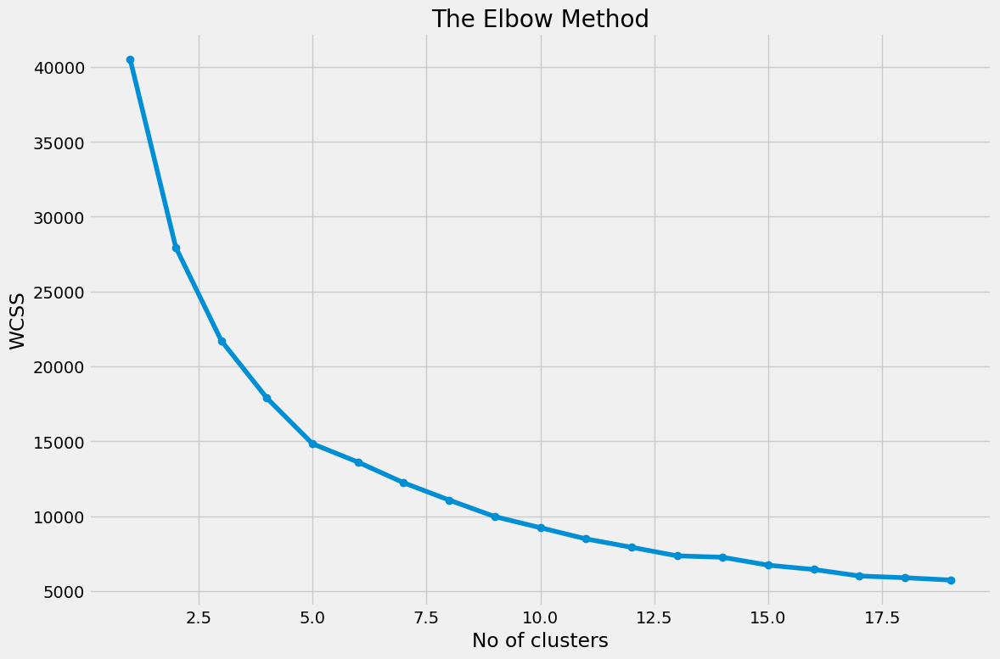

In [206]:
plt.figure(figsize=(12,8))
plt.plot(range(1,20),WCSS,"o-")
plt.title("The Elbow Method")
plt.xlabel("No of clusters")
plt.ylabel("WCSS")
plt.tight_layout()
plt.show()

In [207]:
cluster_kmeans=KMeans(n_clusters=5, init="k-means++", random_state=0)
cluster_kmeans.fit(df_scaled)

KMeans(n_clusters=5, random_state=0)

In [208]:
labels=cluster_kmeans.labels_

In [209]:
cluster_kmeans.cluster_centers_.shape

(5, 11)

In [211]:
cluster_centers = pd.DataFrame(data = cluster_kmeans.cluster_centers_, columns = [df.columns])
cluster_centers

,amount_x,status,loan_account,client_id,card_holding,transcation_frequency,standing_order,gender,age,amount,balance
0,-0.039997,0.095126,0.058167,-0.167378,0.367745,0.0,0.0,-0.053159,-0.119757,10.495258,10.293515
1,-0.314359,-0.399273,-0.401450,-0.220627,-0.497221,0.0,0.0,0.981504,0.177998,-0.070735,-0.084180
2,1.855943,2.351102,2.366060,1.339037,0.149234,0.0,0.0,-0.037192,-0.259381,-0.075018,-0.053804
3,-0.311339,-0.405344,-0.395285,-0.224293,-0.497221,0.0,0.0,-1.018844,0.070453,-0.060198,-0.057448
4,-0.320395,-0.386083,-0.414843,-0.239899,2.011180,0.0,0.0,0.047076,-0.303818,-0.072752,-0.059985


In [212]:
cluster_centers = sc.inverse_transform(cluster_centers)
cluster_centers = pd.DataFrame(data = cluster_centers, columns = [df.columns])
cluster_centers

,amount_x,status,loan_account,client_id,card_holding,transcation_frequency,standing_order,gender,age,amount,balance
0,20149.241379,0.172414,0.172414,2905.862069,3.448276e-01,2.0,1.0,4.827586e-01,42.068966,17588.137931,22309.793103
1,957.704877,-0.007600,0.007600,2754.671311,-6.661338e-16,2.0,1.0,1.000000e+00,47.155795,669.803673,694.373021
2,152770.018519,0.993827,1.000000,7183.010802,2.577160e-01,2.0,1.0,4.907407e-01,39.683642,662.945988,757.641975
3,1168.967953,-0.009810,0.009810,2744.264879,-6.383782e-16,2.0,1.0,-1.332268e-15,45.318509,686.676259,750.052322
4,535.485315,-0.002797,0.002797,2699.952448,1.000000e+00,2.0,1.0,5.328671e-01,38.924476,666.573427,744.767832


In [213]:
labels.min(),labels.max()

(0, 4)

In [214]:
y_kmeans=cluster_kmeans.fit_predict(df_scaled)
y_kmeans

array([3, 2, 2, ..., 1, 1, 1])

In [215]:
df_cluster = pd.concat([df, pd.DataFrame({'cluster':labels})], axis = 1)
df_cluster.head()

,amount_x,status,loan_account,client_id,card_holding,transcation_frequency,standing_order,gender,age,amount,balance,cluster
0,96396.0,-1.0,1.0,2166,0.0,2,1,0.0,51,1100.0,1100.0,3
1,165960.0,1.0,1.0,2181,0.0,2,1,1.0,30,700.0,700.0,2
2,127080.0,1.0,1.0,11314,0.0,2,1,1.0,62,800.0,800.0,2
3,105804.0,1.0,1.0,2235,1.0,2,1,0.0,58,1000.0,1000.0,2
4,274740.0,1.0,1.0,13539,1.0,2,1,1.0,20,600.0,600.0,2


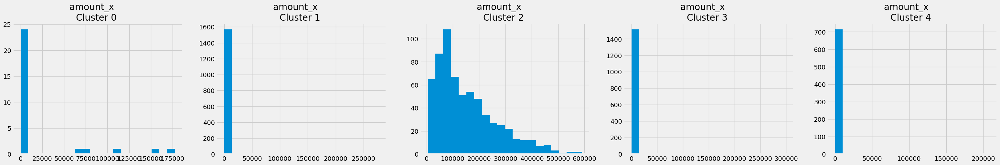

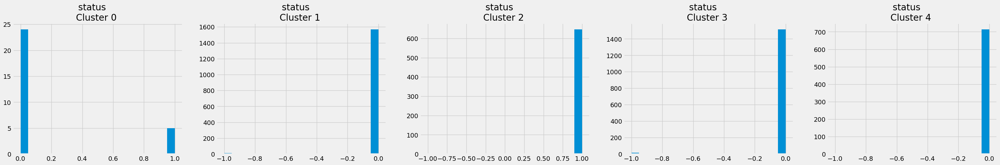

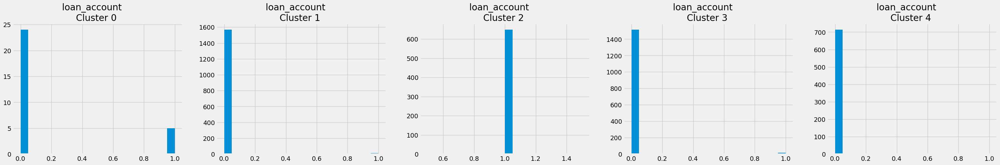

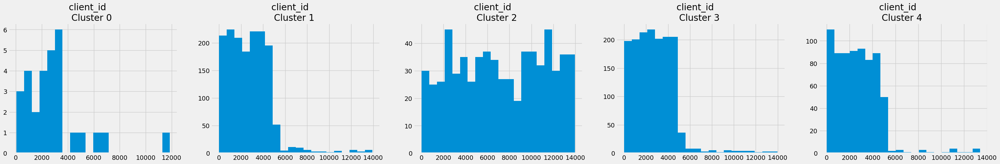

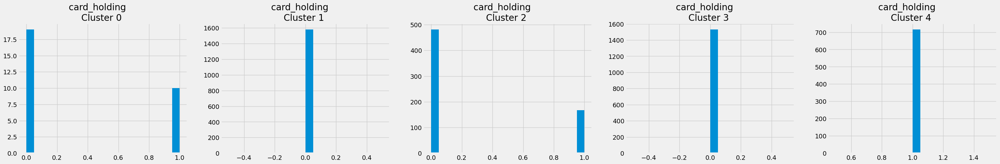

...

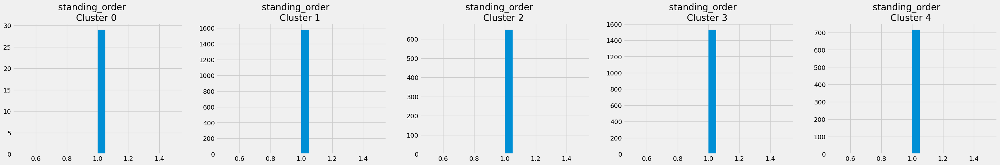

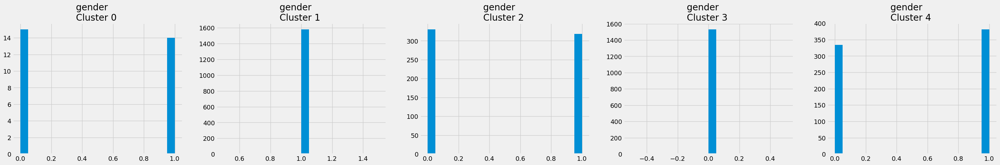

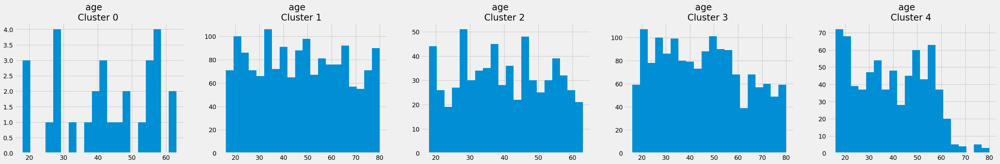

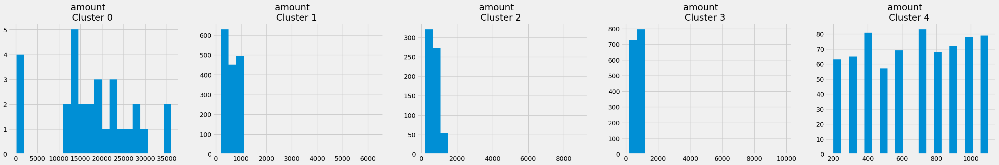

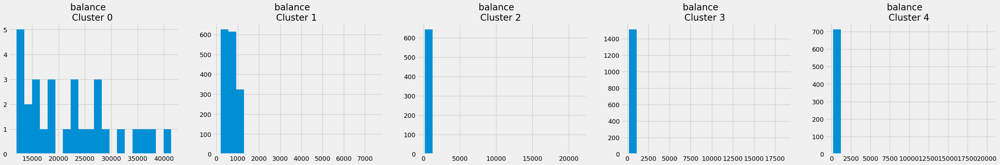

In [216]:
# Plot the histogram of various clusters
for i in df.columns:
    plt.figure(figsize = (35, 5))
    for j in range(5):
        plt.subplot(1, 5, j+1)
        cluster = df_cluster[df_cluster['cluster'] == j]
        cluster[i].hist(bins = 20)
        plt.title('{}    \nCluster {} '.format(i,j))
  
    plt.show()

In [217]:
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
principal_comp = pca.fit_transform(df_scaled)

# Check data
principal_comp

array([[-0.06749342,  0.1959189 ],
       [ 3.43670766, -0.10959908],
       [ 4.25142666, -0.07742632],
       ...,
       [-1.09879669, -0.44357518],
       [-1.04230203,  0.09355244],
       [-0.50122052,  0.10175922]])

In [218]:
pca_df = pd.DataFrame(data = principal_comp, columns =['pca1','pca2'])
pca_df.head()

,pca1,pca2
0,-0.067493,0.195919
1,3.436708,-0.109599
2,4.251427,-0.077426
3,3.026917,0.258678
4,6.007961,-0.125372


In [219]:
# Concatenate the clusters labels to the dataframe
pca_df = pd.concat([pca_df, pd.DataFrame({'cluster':labels})], axis = 1)
pca_df.head()

,pca1,pca2,cluster
0,-0.067493,0.195919,3
1,3.436708,-0.109599,2
2,4.251427,-0.077426,2
3,3.026917,0.258678,2
4,6.007961,-0.125372,2


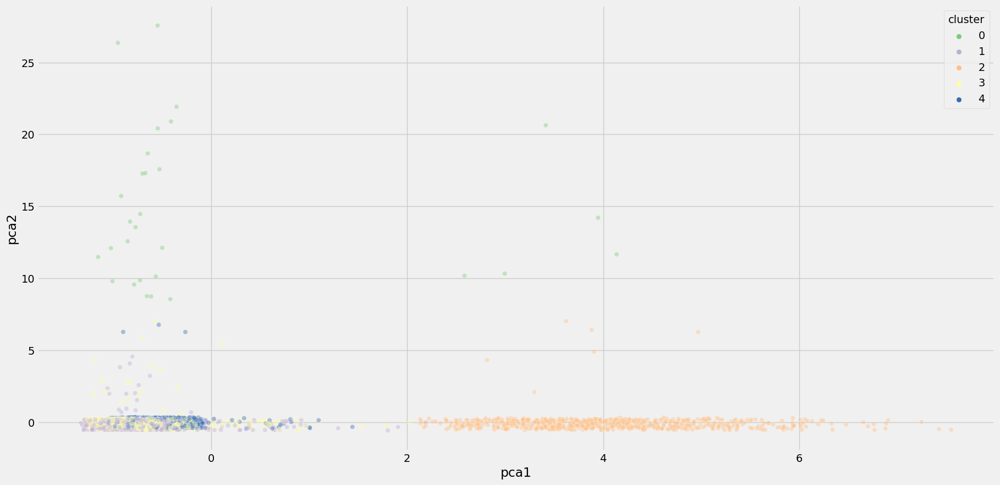

In [220]:
# Visualize the clusters
plt.figure(figsize=(20,10))
ax = sns.scatterplot(x="pca1", y="pca2",alpha=0.4,hue="cluster",data = pca_df,palette="Accent")
plt.show()